<a href="https://colab.research.google.com/github/MohmikaK/Team-SQuAD-Tasks/blob/main/Combined.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import numpy as np
from scipy.stats import skew, kurtosis
from skimage.measure import shannon_entropy
import matplotlib.pyplot as plt
import os
from google.colab import drive
import pandas as pd
from PIL import Image
from google.colab.patches import cv2_imshow
from skimage.metrics import peak_signal_noise_ratio, mean_squared_error

Feature extraction function


In [ ]:
def extract_features(image):
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate mean and standard deviation
    mean_intensity = np.mean(gray_image)
    std_intensity = np.std(gray_image)

    # Calculate skewness and kurtosis
    skewness = skew(gray_image.flatten())
    kurt = kurtosis(gray_image.flatten())

    # Calculate entropy
    entropy = shannon_entropy(gray_image)

    return mean_intensity, std_intensity, skewness, kurt, entropy



In [ ]:
drive.mount('/content/drive')
folder_path='/content/drive/My Drive/frames'
file_list = os.listdir(folder_path)

Save image path followed by its features into a dataframe


In [ ]:
df = pd.DataFrame(columns=['path_to_image', 'mean_intensity', 'std_intensity', 'skewness','kurt','entropy','clip_limit','grid_size'])

In [ ]:
for foldername in file_list:
    # Skip if the item is not a directory
    if not os.path.isdir(os.path.join(folder_path, foldername)):
        continue

    # Iterate through images in the folder
    for filename in os.listdir(os.path.join(folder_path, foldername)):
        if filename.endswith('.png') or filename.endswith('.jpg'):
            image_path = os.path.join(folder_path, foldername, filename)
            image = cv2.imread(image_path)
            features = extract_features(image)
            # Append a new row to the DataFrame with the image path and features
            df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)
            print(df)

<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0        1.88524  14.749312  1152.671041  1.804917        NaN       NaN  


<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  


<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212        NaN       NaN  


<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   
3  /content/drive/My Drive/frames/20221021_00/fra...       19.095710   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212        NaN       NaN  
3      16.263418   1.185256     1.401435  5.583037        NaN       NaN  


<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   
3  /content/drive/My Drive/frames/20221021_00/fra...       19.095710   
4  /content/drive/My Drive/frames/20221021_00/fra...        5.941902   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212        NaN       NaN  
3      16.263418   1.185256     1.401435  5.583037        NaN       NaN  
4       6.183962   2.385815    21.749580  3.982599        NaN       NaN  


<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   
3  /content/drive/My Drive/frames/20221021_00/fra...       19.095710   
4  /content/drive/My Drive/frames/20221021_00/fra...        5.941902   
5  /content/drive/My Drive/frames/20221021_00/fra...        7.646898   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212        NaN       NaN  
3      16.263418   1.185256     1.401435  5.583037        NaN       NaN  
4       6.183962   2.385815    21.749580  3.982599        NaN       NaN  
5       7.840133   2.014865    10.903923  4.343448 

<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   
3  /content/drive/My Drive/frames/20221021_00/fra...       19.095710   
4  /content/drive/My Drive/frames/20221021_00/fra...        5.941902   
5  /content/drive/My Drive/frames/20221021_00/fra...        7.646898   
6  /content/drive/My Drive/frames/20221021_00/fra...       18.788064   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212        NaN       NaN  
3      16.263418   1.185256     1.401435  5.583037        NaN       NaN  
4       6.183962   2.385815    21.749580  3.982599   

<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   
3  /content/drive/My Drive/frames/20221021_00/fra...       19.095710   
4  /content/drive/My Drive/frames/20221021_00/fra...        5.941902   
5  /content/drive/My Drive/frames/20221021_00/fra...        7.646898   
6  /content/drive/My Drive/frames/20221021_00/fra...       18.788064   
7  /content/drive/My Drive/frames/20221021_00/fra...        9.987987   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212        NaN       NaN  
3      16.263418   1.185256     1.401435  5.583037     

<ipython-input-28-4c6cb6072044>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'path_to_image': image_path, 'mean_intensity': features[0], 'std_intensity': features[1], 'skewness': features[2],'kurt': features[3],'entropy':features[4]}, ignore_index=True)


                                       path_to_image  mean_intensity  \
0  /content/drive/My Drive/frames/20221021_00/fra...        0.931688   
1  /content/drive/My Drive/frames/20221021_00/fra...        2.558106   
2  /content/drive/My Drive/frames/20221021_00/fra...        0.303704   
3  /content/drive/My Drive/frames/20221021_00/fra...       19.095710   
4  /content/drive/My Drive/frames/20221021_00/fra...        5.941902   
5  /content/drive/My Drive/frames/20221021_00/fra...        7.646898   
6  /content/drive/My Drive/frames/20221021_00/fra...       18.788064   
7  /content/drive/My Drive/frames/20221021_00/fra...        9.987987   
8  /content/drive/My Drive/frames/20221021_00/fra...       14.975500   

   std_intensity   skewness         kurt   entropy clip_limit grid_size  
0       1.885240  14.749312  1152.671041  1.804917        NaN       NaN  
1       3.699154   4.583497   120.578554  2.957426        NaN       NaN  
2       1.001360  58.530286  9828.893632  0.937212       

KeyboardInterrupt: 

In [ ]:
df

,path_to_image,mean_intensity,std_intensity,skewness,kurt,entropy,clip_limit,grid_size
0,/content/drive/My Drive/frames/20221021_00/fra...,0.931688,1.885240,14.749312,1152.671041,1.804917,NaN,NaN
1,/content/drive/My Drive/frames/20221021_00/fra...,2.558106,3.699154,4.583497,120.578554,2.957426,NaN,NaN
2,/content/drive/My Drive/frames/20221021_00/fra...,0.303704,1.001360,58.530286,9828.893632,0.937212,NaN,NaN
3,/content/drive/My Drive/frames/20221021_00/fra...,19.095710,16.263418,1.185256,1.401435,5.583037,NaN,NaN
4,/content/drive/My Drive/frames/20221021_00/fra...,5.941902,6.183962,2.385815,21.749580,3.982599,NaN,NaN
5,/content/drive/My Drive/frames/20221021_00/fra...,7.646898,7.840133,2.014865,10.903923,4.343448,NaN,NaN
6,/content/drive/My Drive/frames/20221021_00/fra...,18.788064,16.265447,1.194319,1.415220,5.553953,NaN,NaN
7,/content/drive/My Drive/frames/20221021_00/fra...,9.987987,9.562686,1.766447,6.607256,4.696634,NaN,NaN
8,/content/drive/My Drive/frames/20221021_00/fra...,14.975500,13.513248,1.393262,2.648866,5.235305,NaN,NaN


CLAHE FUNCTIONS

In [ ]:
def enhance(image_path, clip_limit):

    #cv2_imshow(image)
    # convert image to LAB color model
    image_lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)

    # split the image into L, A, and B channels
    l_channel, a_channel, b_channel = cv2.split(image_lab)

    # apply CLAHE to lightness channel
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=(8, 8))
    cl = clahe.apply(l_channel)

    # merge the CLAHE enhanced L channel with the original A and B channel
    merged_channels = cv2.merge((cl, a_channel, b_channel))

    # convert iamge from LAB color model back to RGB color model
    final_image = cv2.cvtColor(merged_channels, cv2.COLOR_LAB2BGR)
    return final_image

def resize_image(image, target_size):
    # Resize the image to the target size
    return cv2.resize(image, target_size)

def enhance_and_display(image_path, clip_limit=1.55, target_size=(3840, 2160)):
    # Read the original image
    original_image = cv2.imread(image_path)

    # Enhance the original image
    enhanced_image = enhance(original_image, clip_limit=clip_limit)

    # Resize the enhanced image
    enhanced_image_resized = resize_image(enhanced_image, target_size)

    # Convert the resized enhanced image to PIL format for display
    pil_image = Image.fromarray(cv2.cvtColor(enhanced_image_resized, cv2.COLOR_BGR2RGB))

    # Display the enhanced image
    #display(pil_image)

    return enhanced_image_resized, original_image


VARYING CLIP LIMITS AND TESTING USING PSNR FOR EVALUATION

In [ ]:
clip_limits = [1.0, 1.2,1.4, 1.8, 2.0, 2.2,2.4, 3.0]
tile_grid_sizes = [(8, 8), (16, 16), (32, 32), (64,64), (128, 128), (256, 256), (512, 512)]


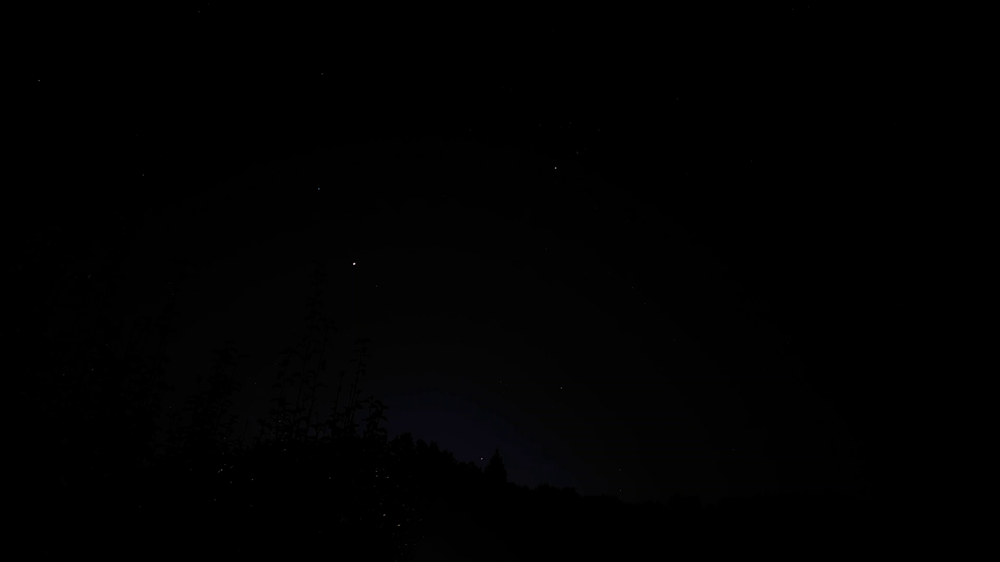

Clip Limit: 0.5, Tile Grid Size: (8, 8)


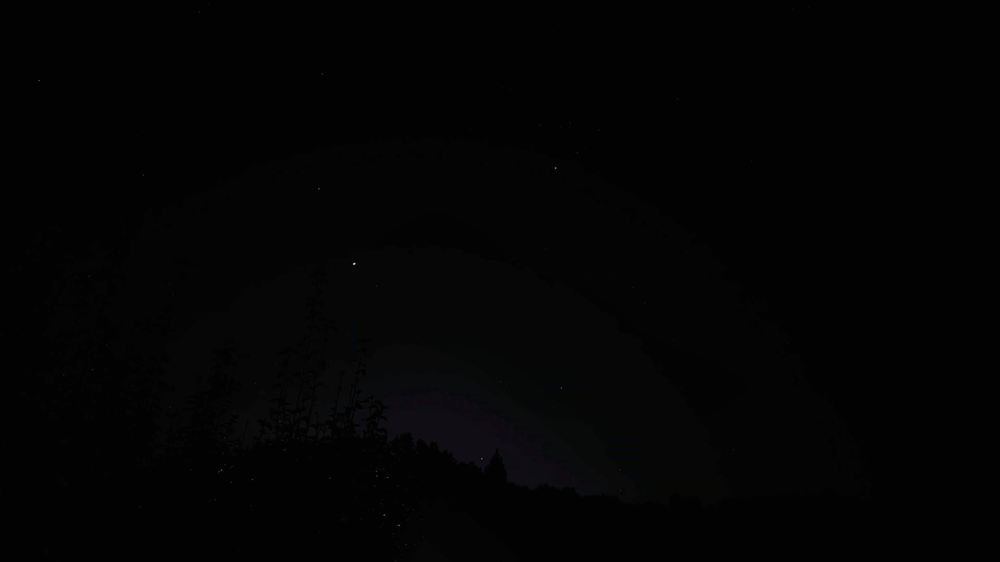

Clip Limit: 0.5, Tile Grid Size: (16, 16)


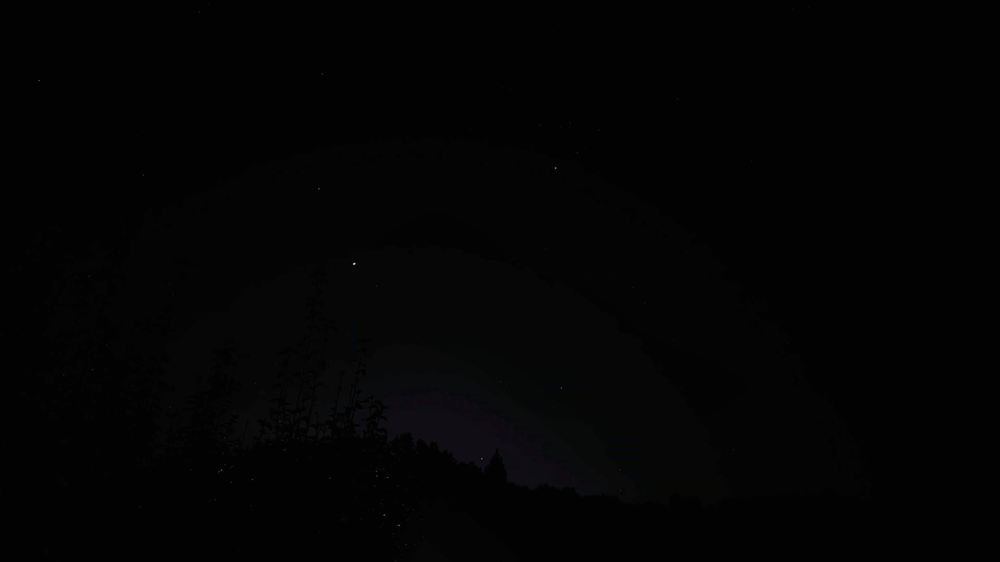

Clip Limit: 0.5, Tile Grid Size: (32, 32)


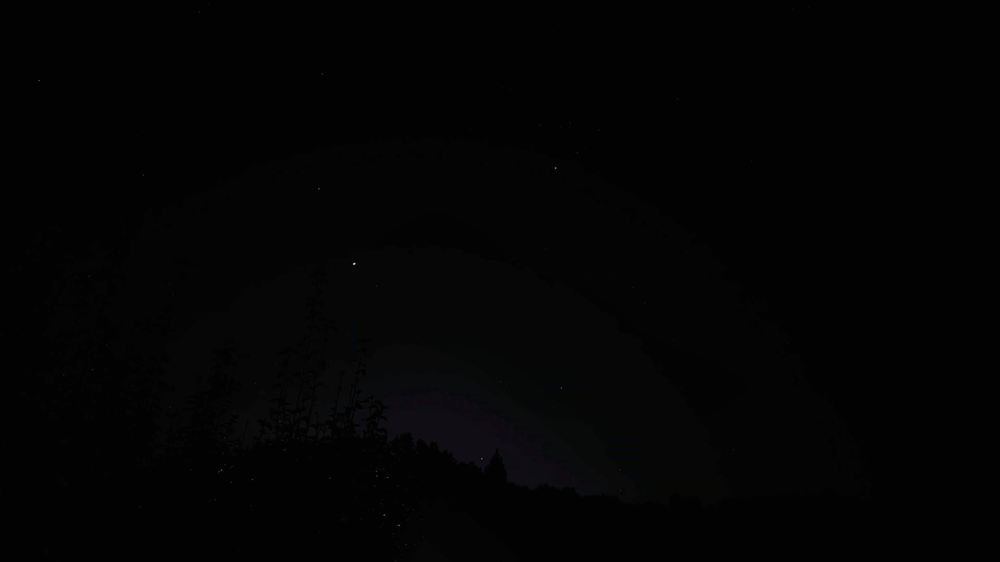

Clip Limit: 0.5, Tile Grid Size: (64, 64)


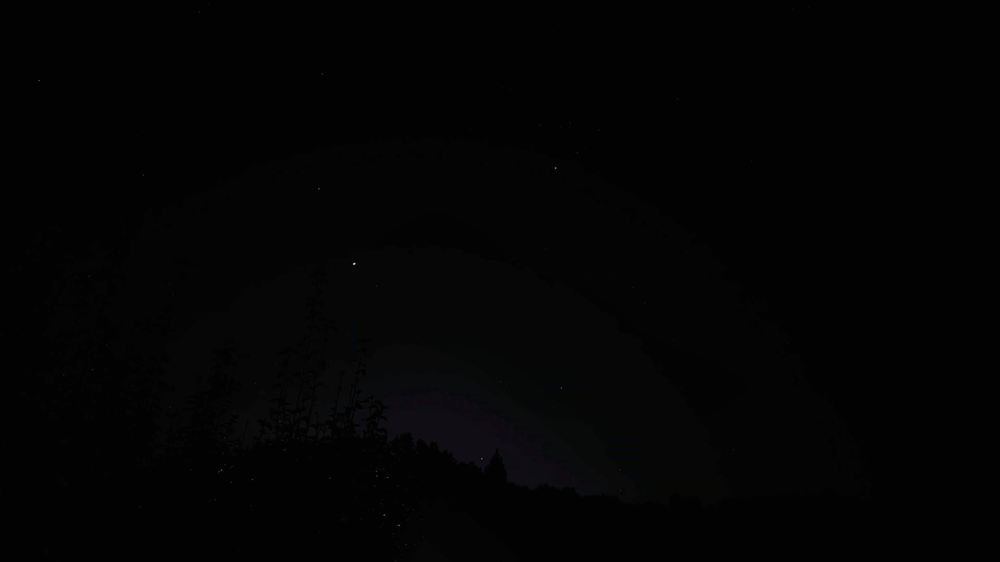

Clip Limit: 0.5, Tile Grid Size: (128, 128)


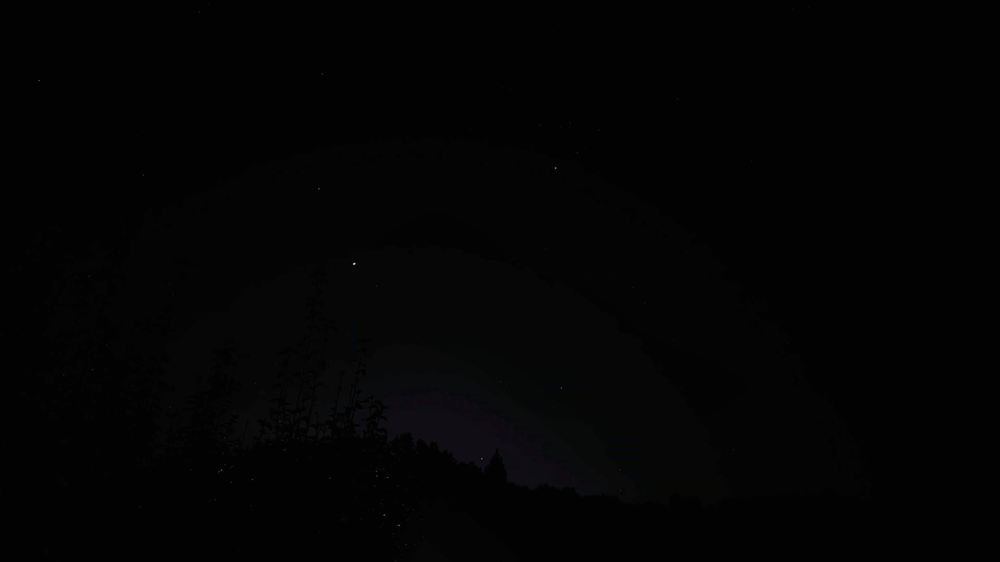

Clip Limit: 0.5, Tile Grid Size: (256, 256)


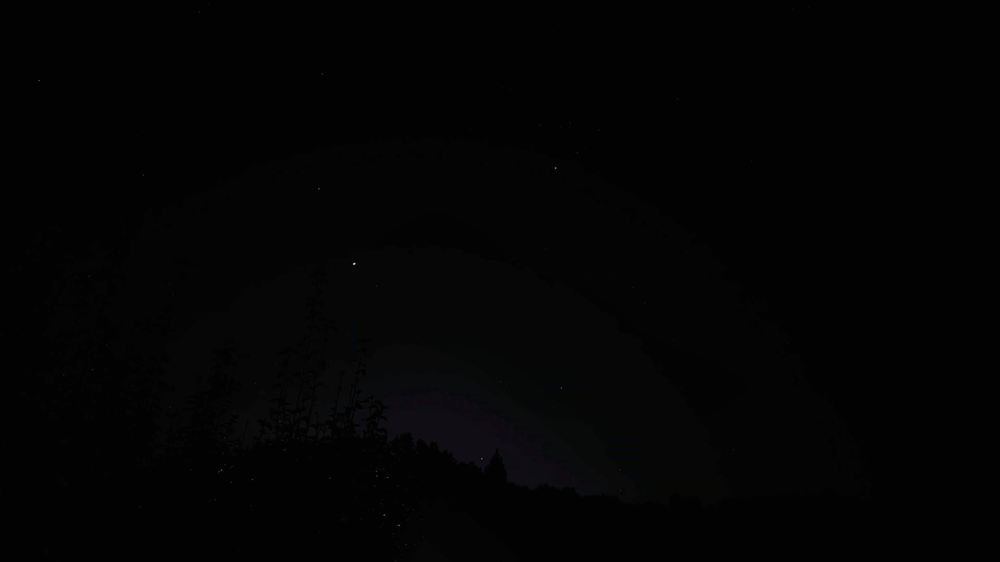

Clip Limit: 0.5, Tile Grid Size: (512, 512)


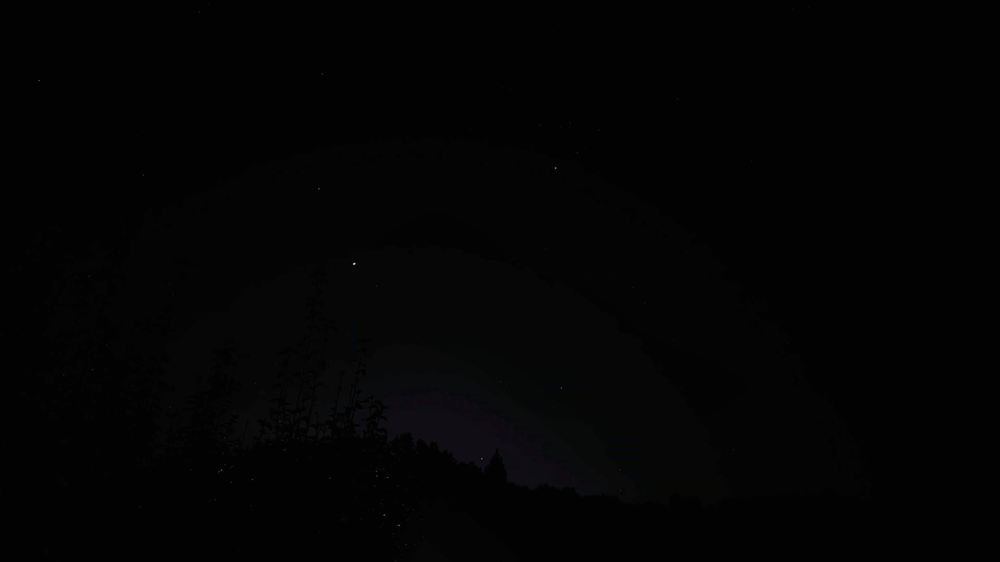

Clip Limit: 1.0, Tile Grid Size: (8, 8)


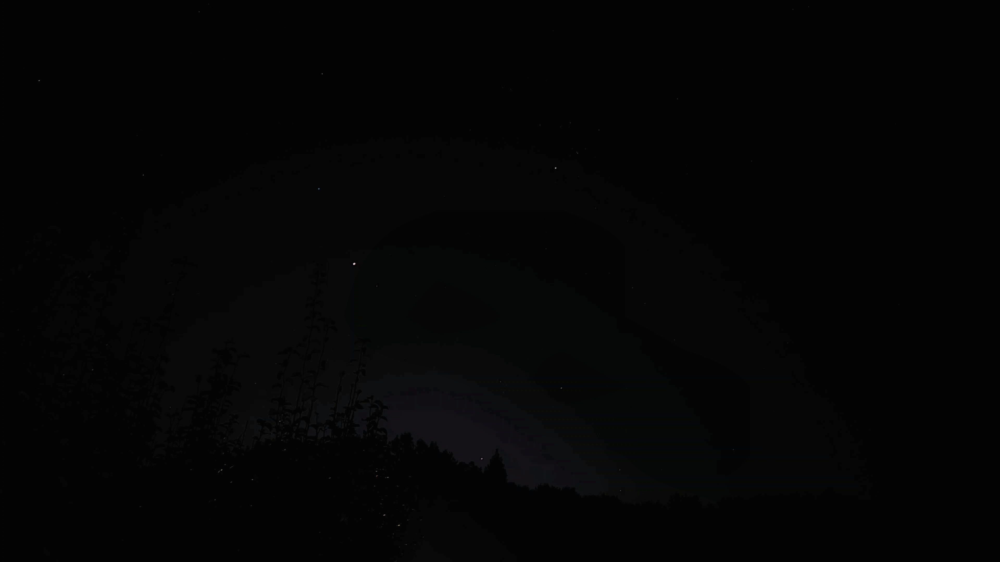

Clip Limit: 1.0, Tile Grid Size: (16, 16)


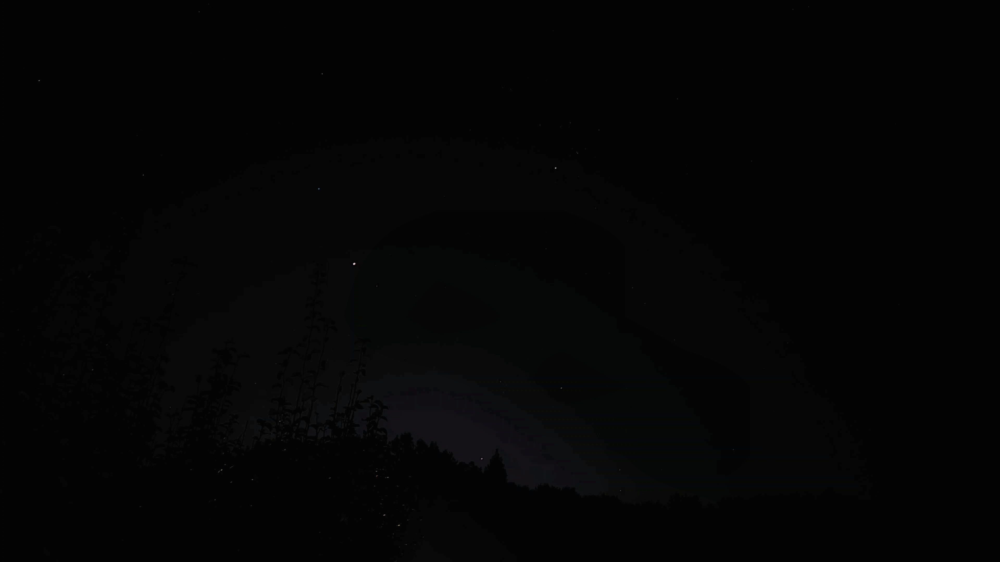

Clip Limit: 1.0, Tile Grid Size: (32, 32)


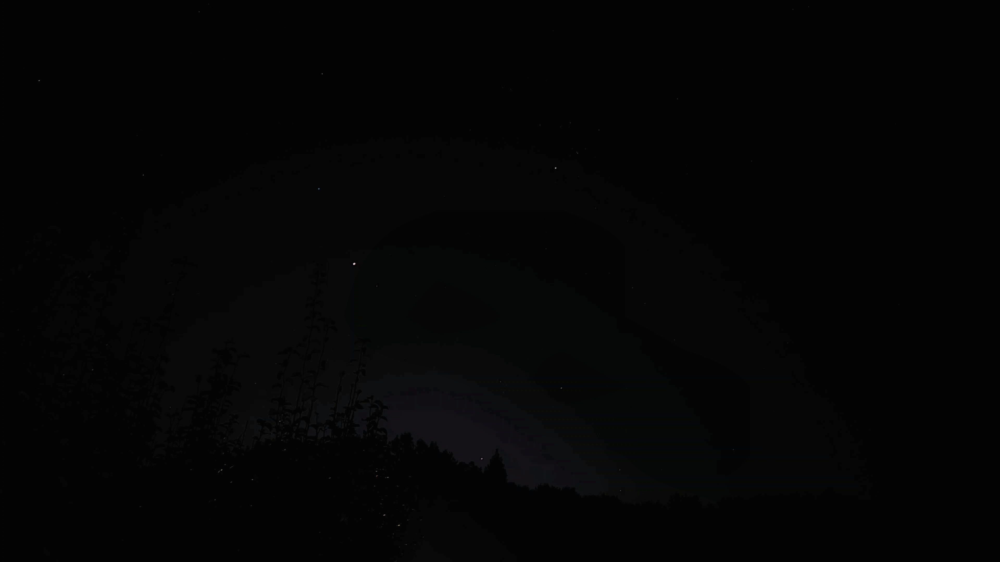

Clip Limit: 1.0, Tile Grid Size: (64, 64)


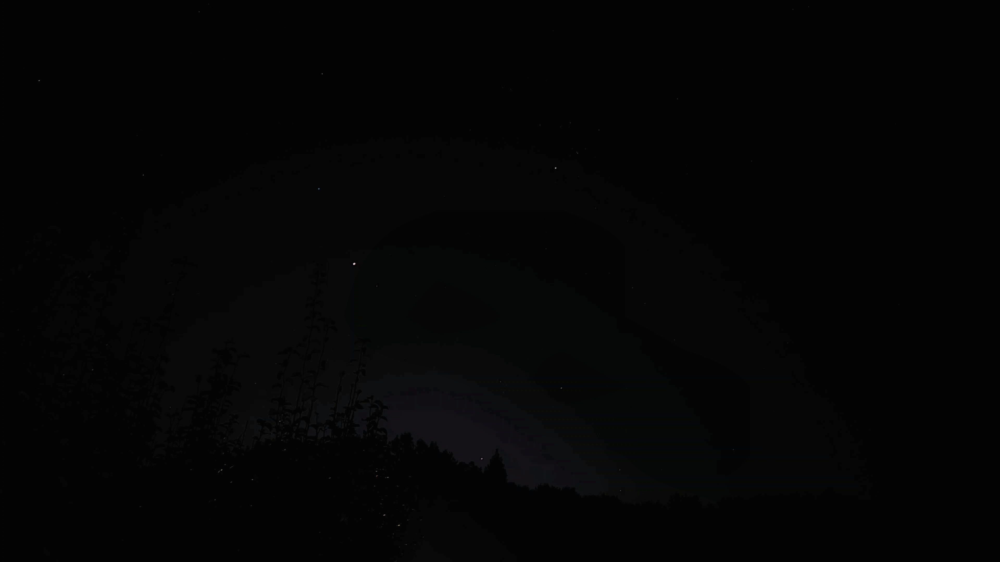

Clip Limit: 1.0, Tile Grid Size: (128, 128)


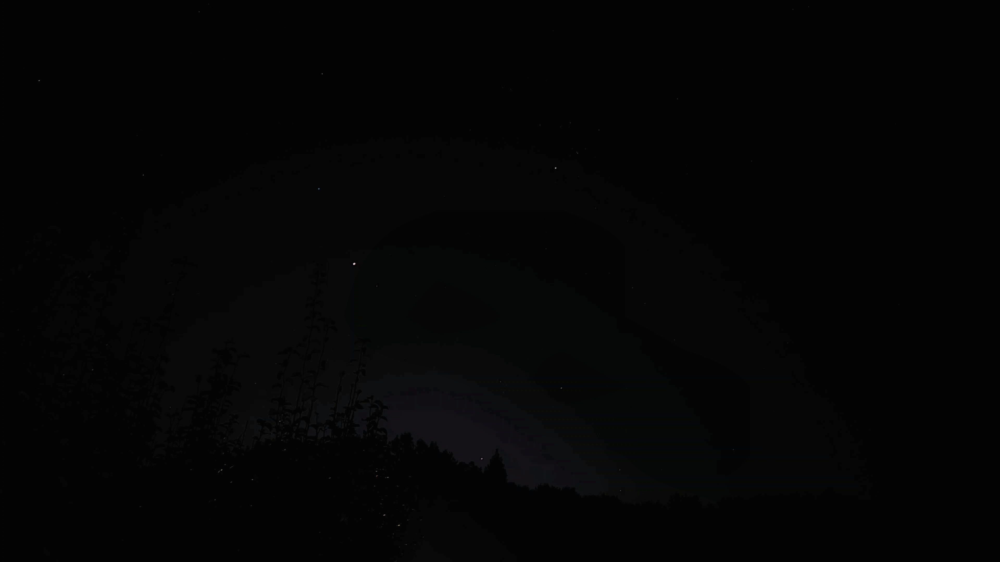

Clip Limit: 1.0, Tile Grid Size: (256, 256)


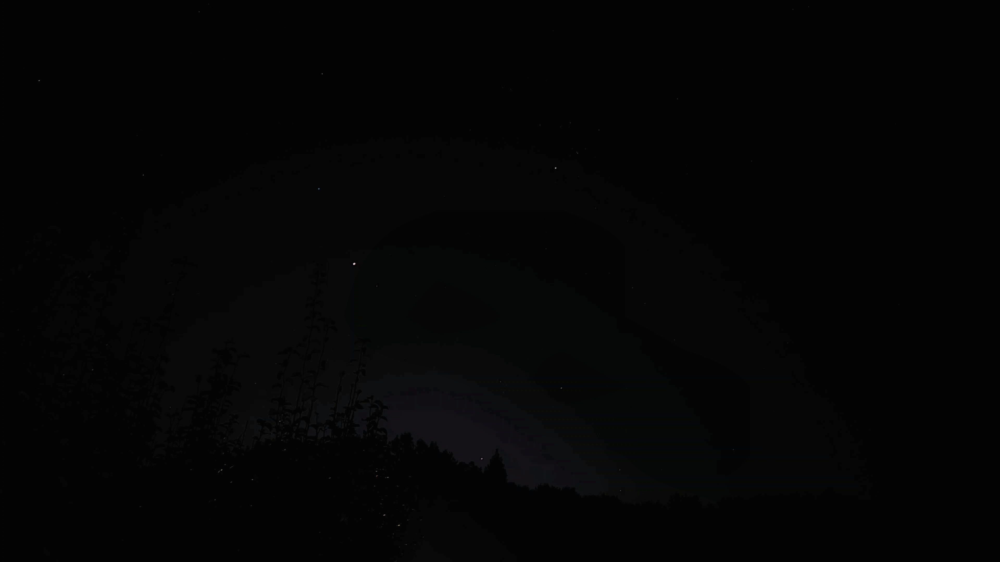

Clip Limit: 1.0, Tile Grid Size: (512, 512)


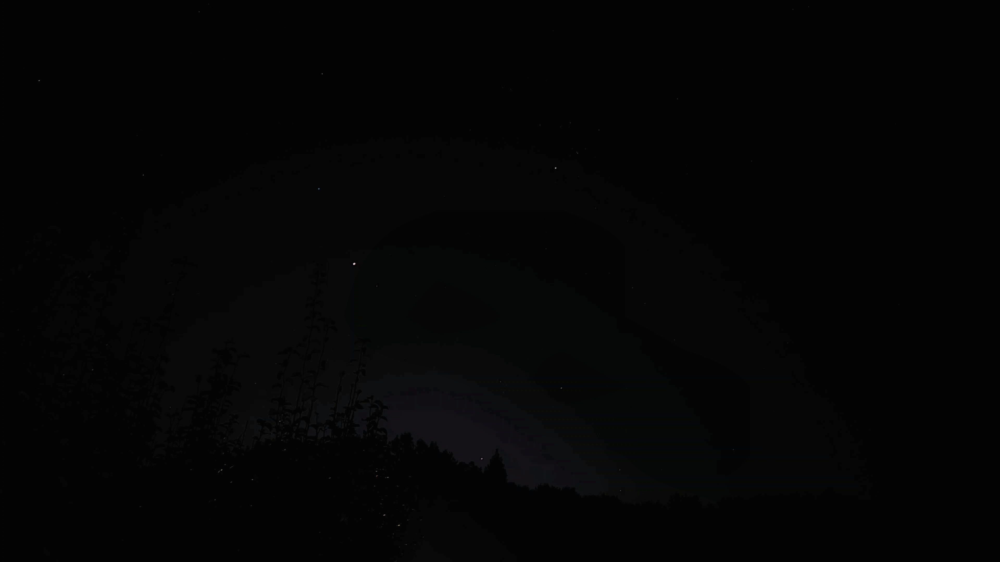

Clip Limit: 1.5, Tile Grid Size: (8, 8)


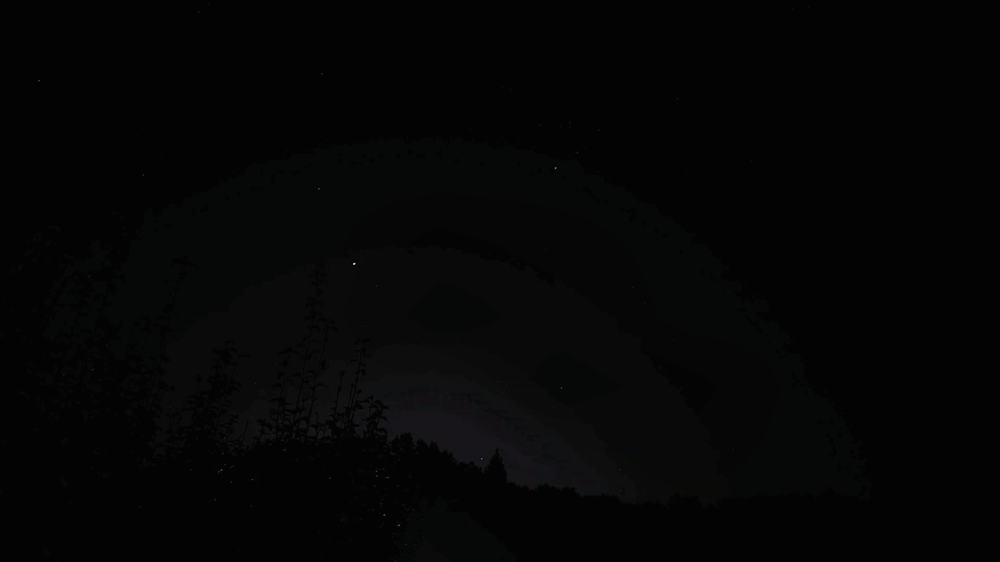

Clip Limit: 1.5, Tile Grid Size: (16, 16)


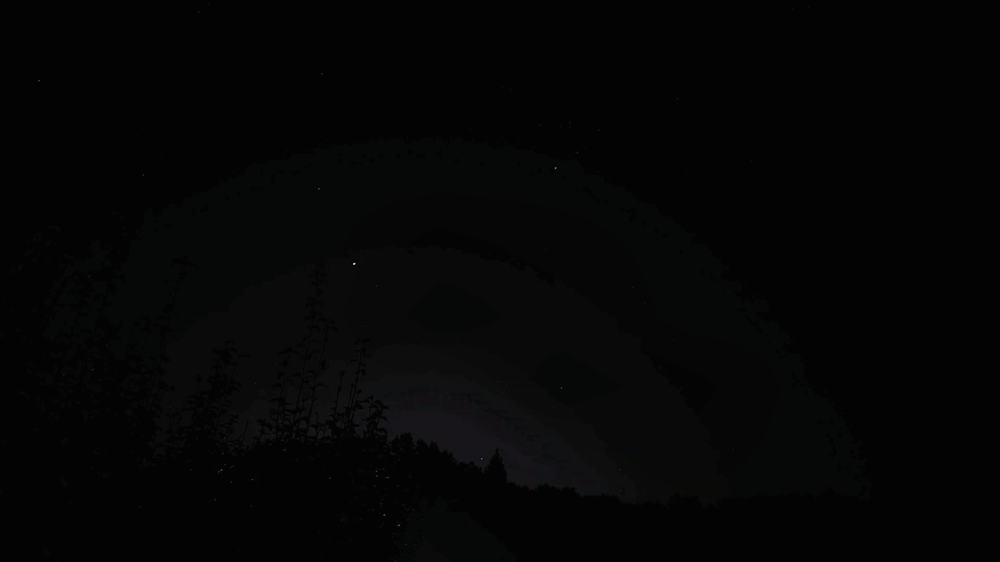

Clip Limit: 1.5, Tile Grid Size: (32, 32)


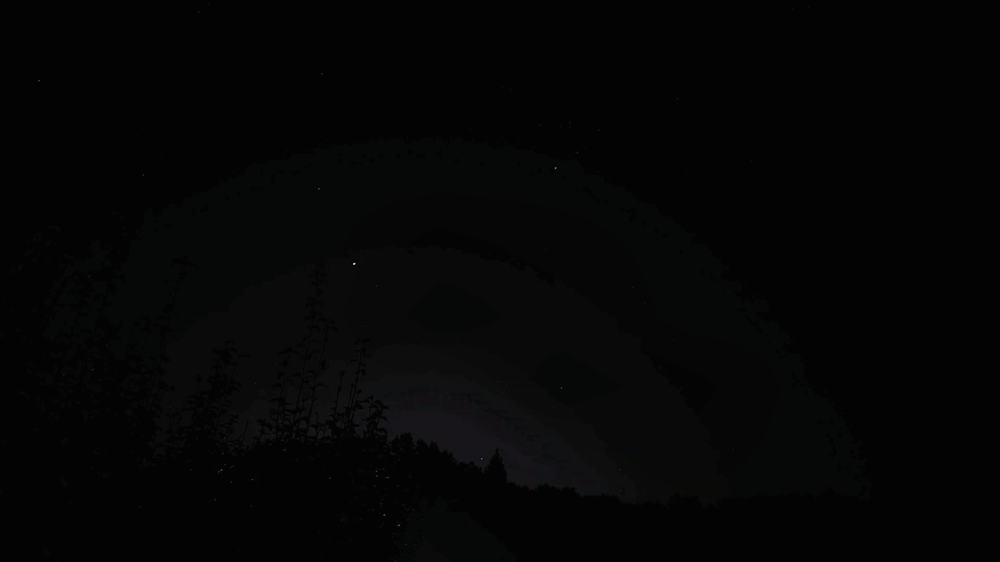

Clip Limit: 1.5, Tile Grid Size: (64, 64)


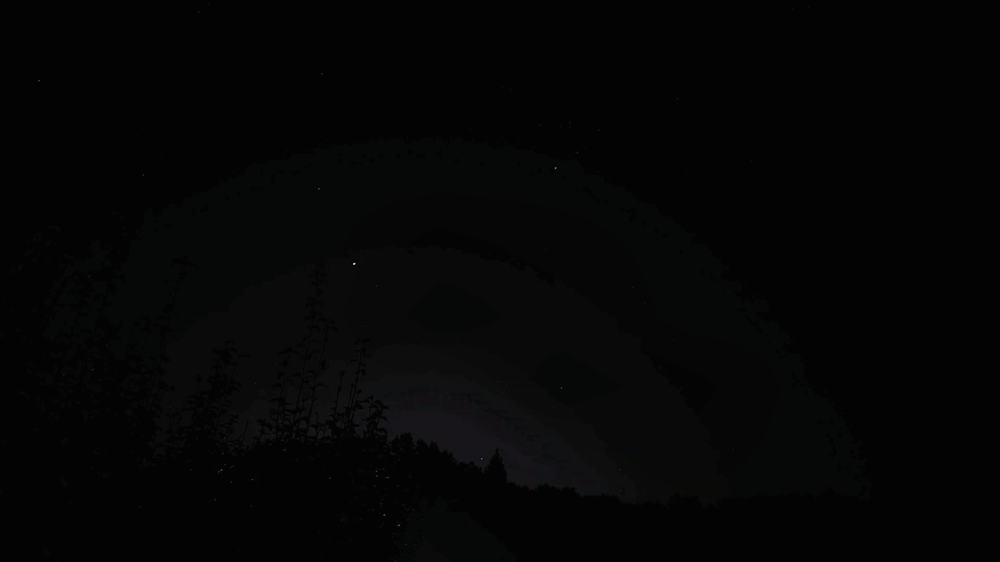

Clip Limit: 1.5, Tile Grid Size: (128, 128)


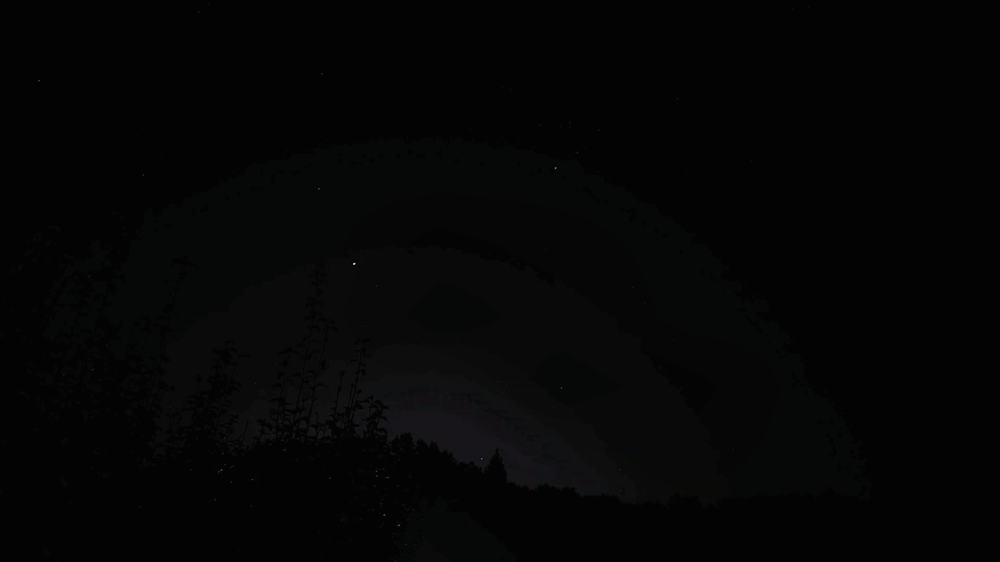

Clip Limit: 1.5, Tile Grid Size: (256, 256)


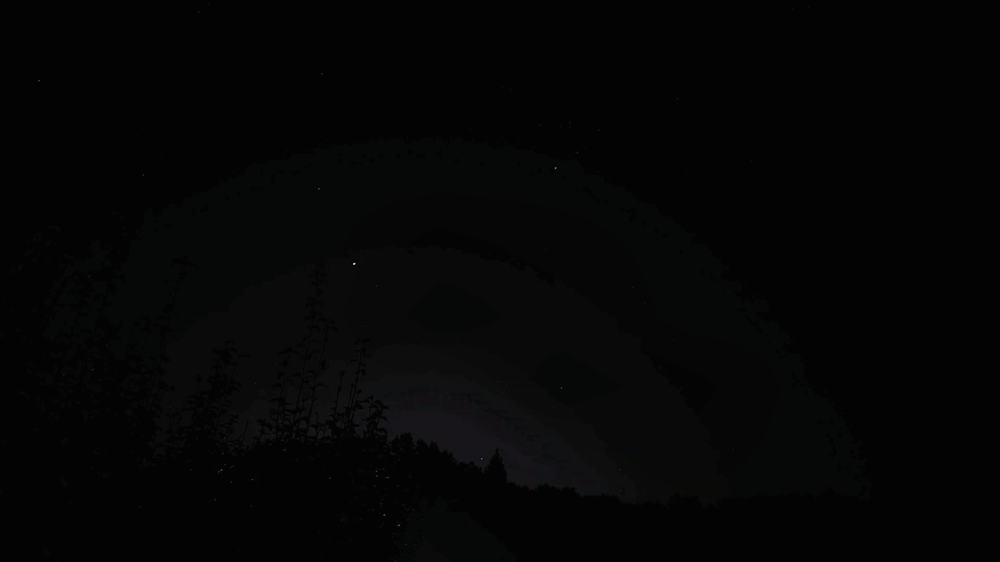

Clip Limit: 1.5, Tile Grid Size: (512, 512)


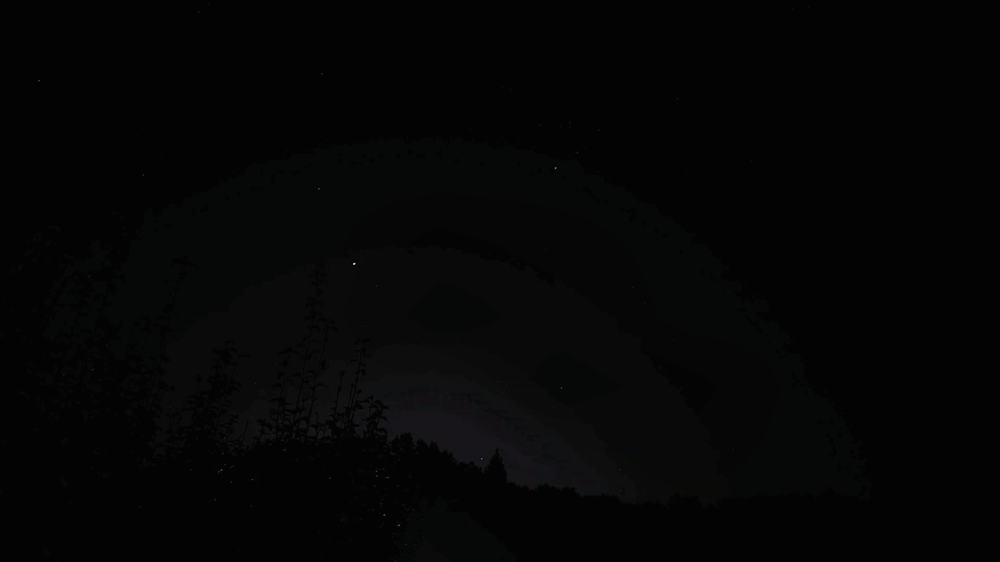

Clip Limit: 2.0, Tile Grid Size: (8, 8)


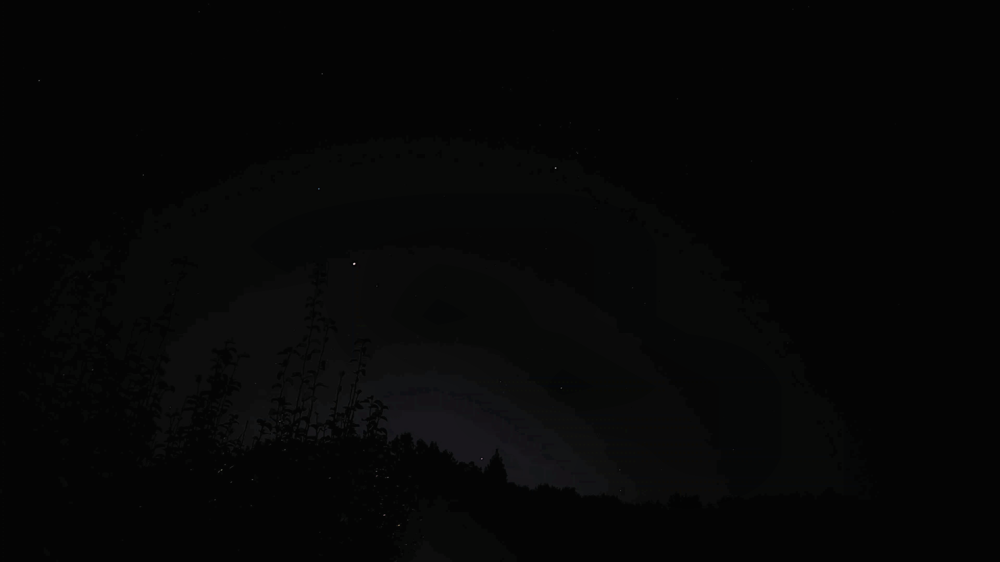

Clip Limit: 2.0, Tile Grid Size: (16, 16)


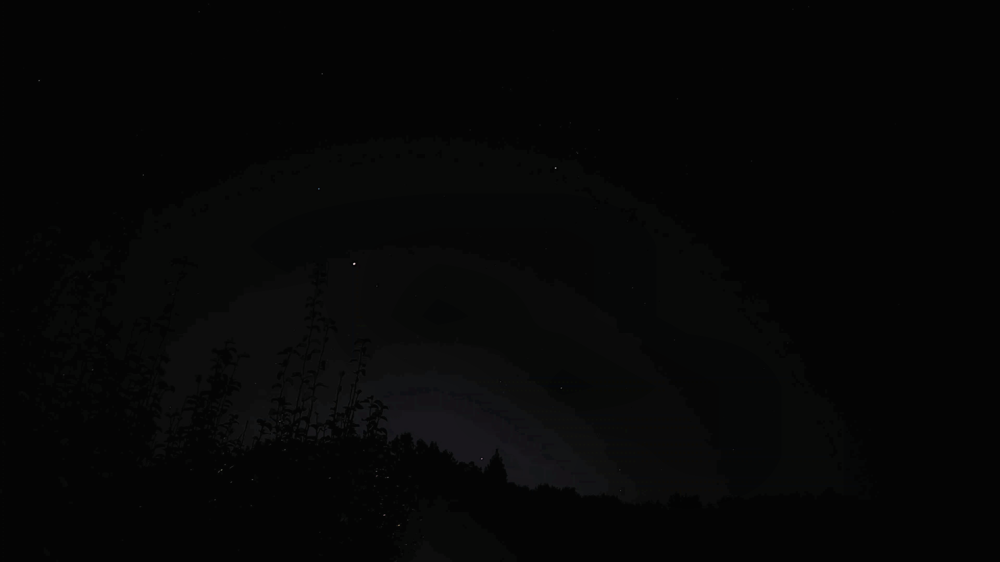

Clip Limit: 2.0, Tile Grid Size: (32, 32)


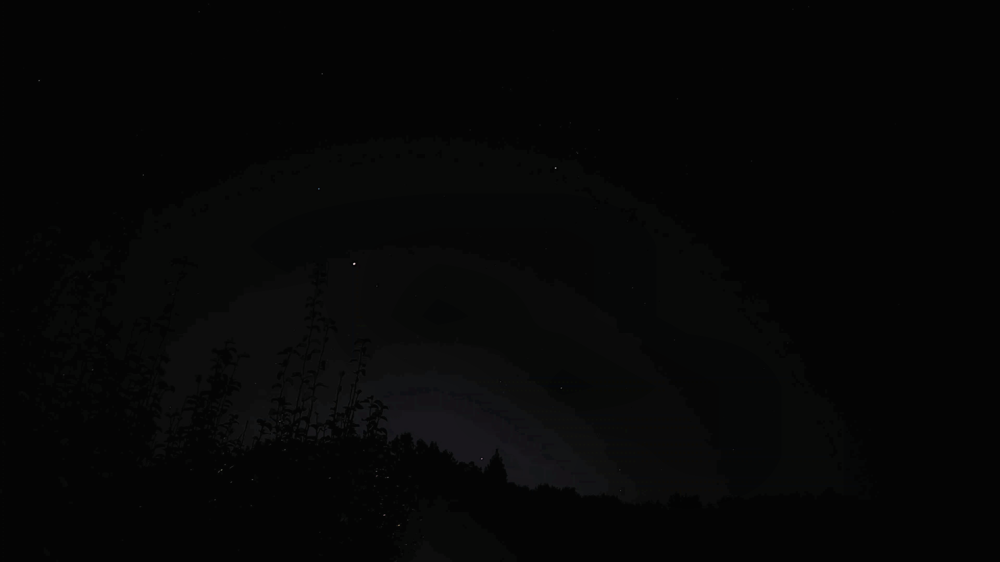

Clip Limit: 2.0, Tile Grid Size: (64, 64)


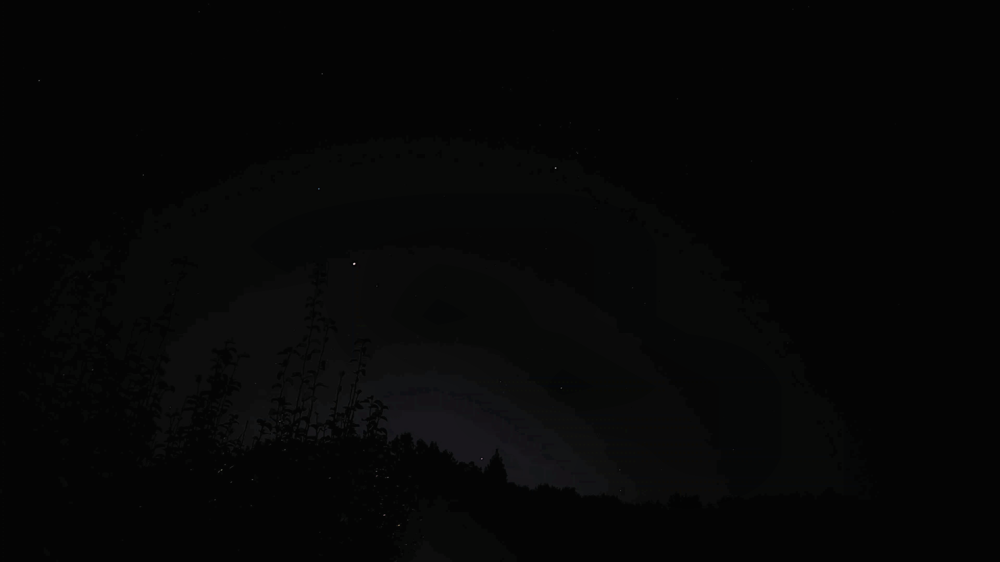

Clip Limit: 2.0, Tile Grid Size: (128, 128)


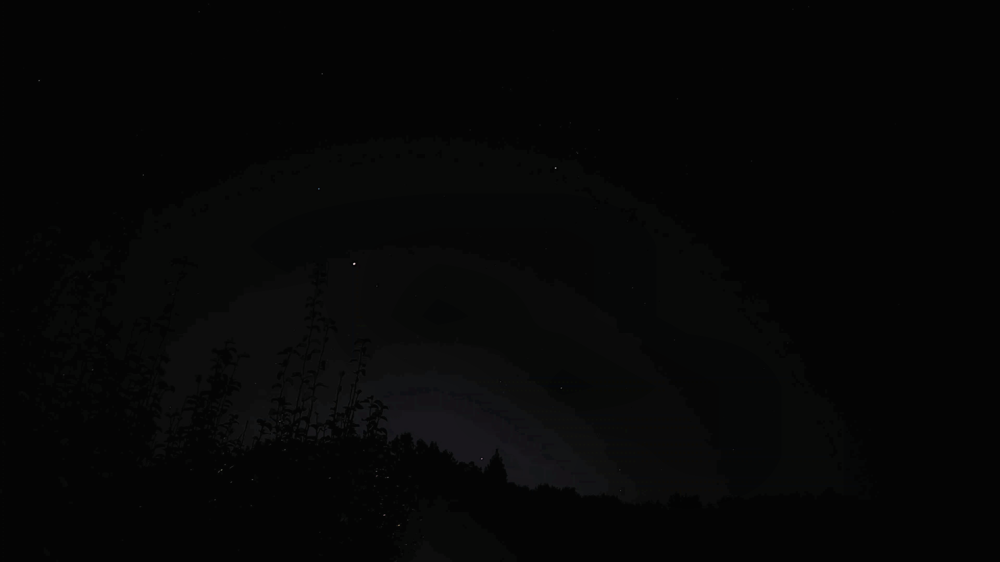

Clip Limit: 2.0, Tile Grid Size: (256, 256)


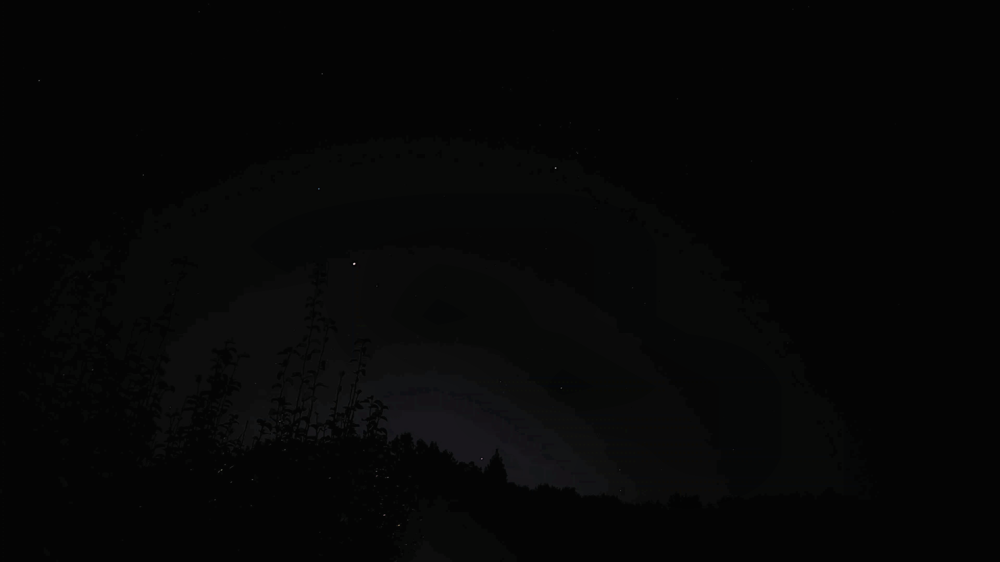

Clip Limit: 2.0, Tile Grid Size: (512, 512)


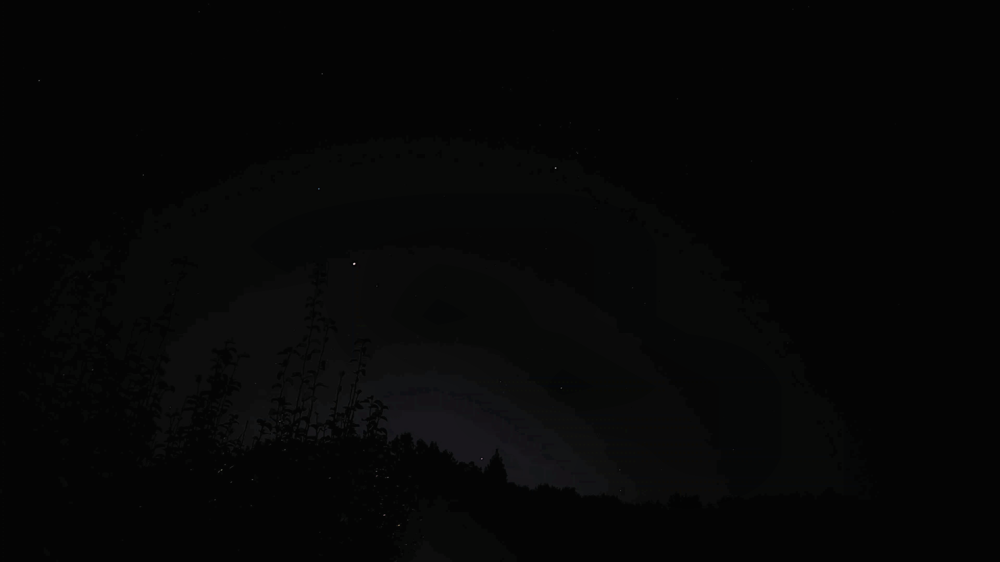

Clip Limit: 2.5, Tile Grid Size: (8, 8)


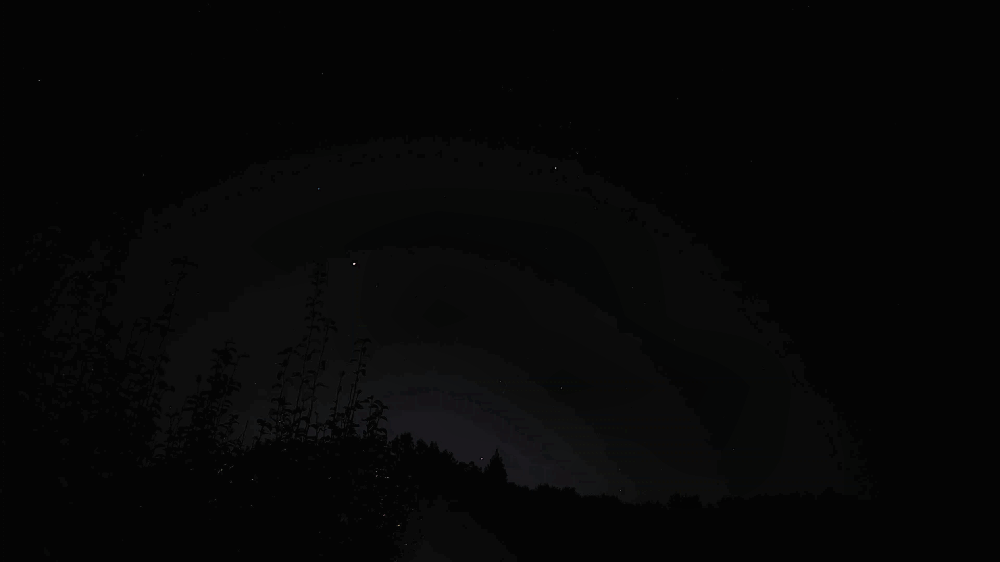

Clip Limit: 2.5, Tile Grid Size: (16, 16)


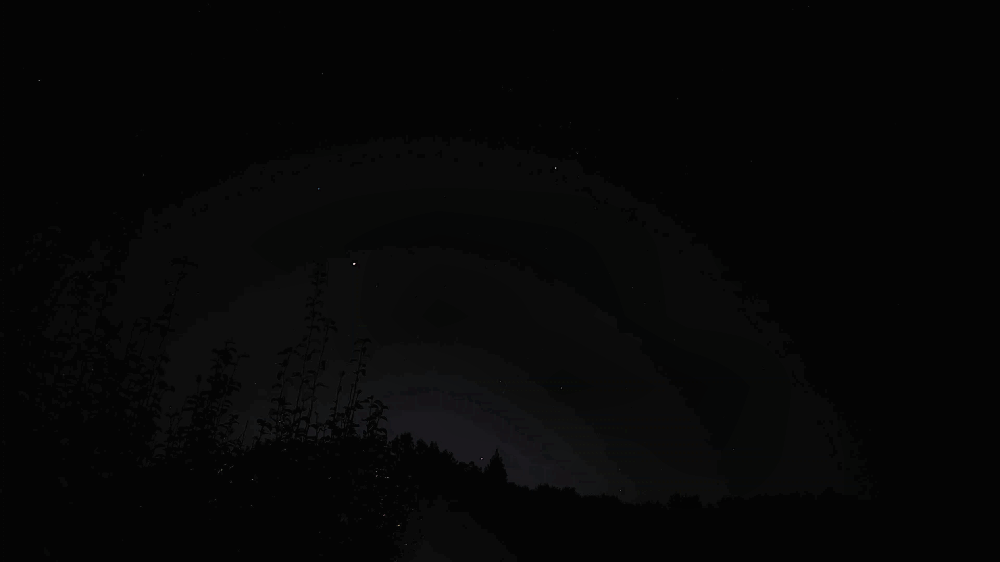

Clip Limit: 2.5, Tile Grid Size: (32, 32)


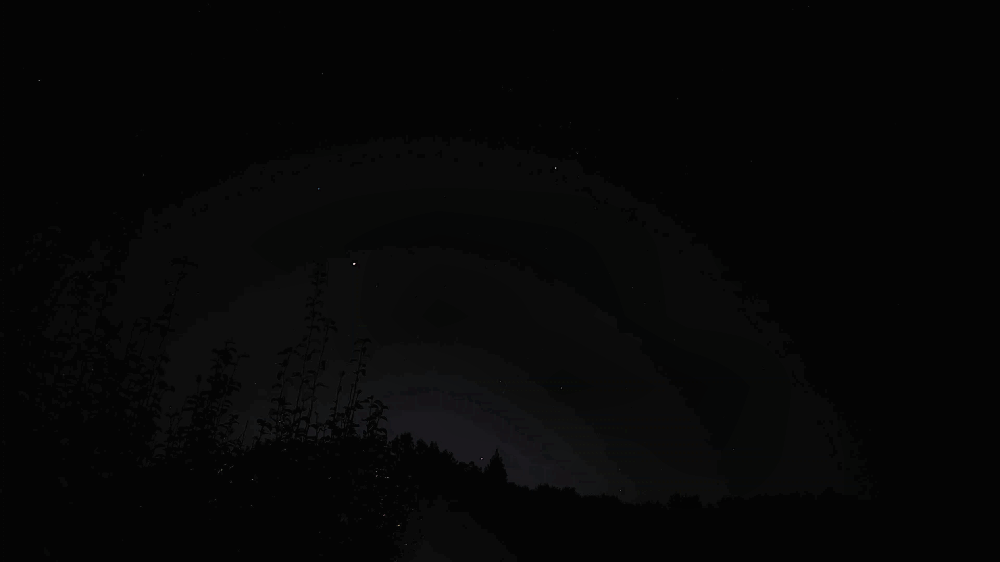

Clip Limit: 2.5, Tile Grid Size: (64, 64)


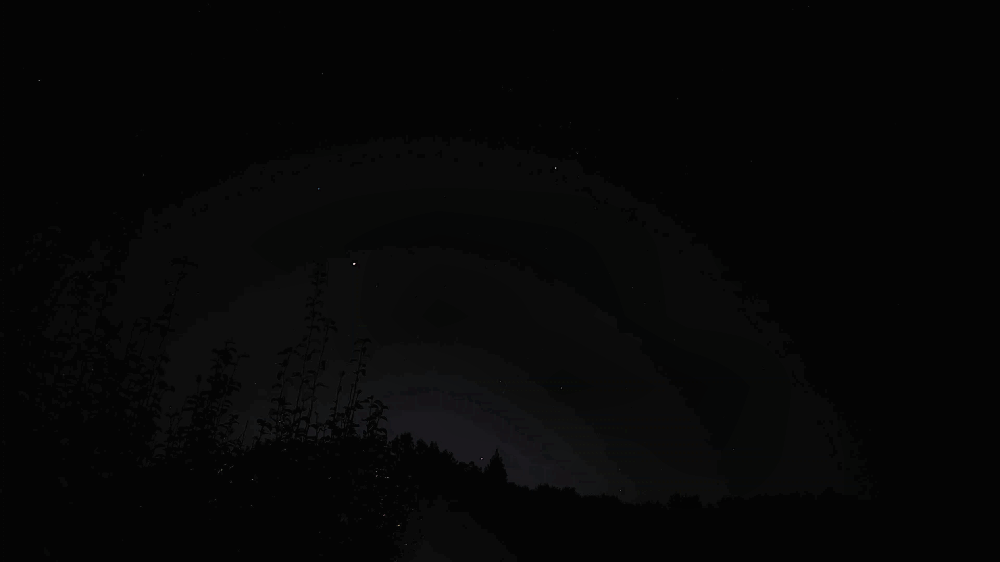

Clip Limit: 2.5, Tile Grid Size: (128, 128)


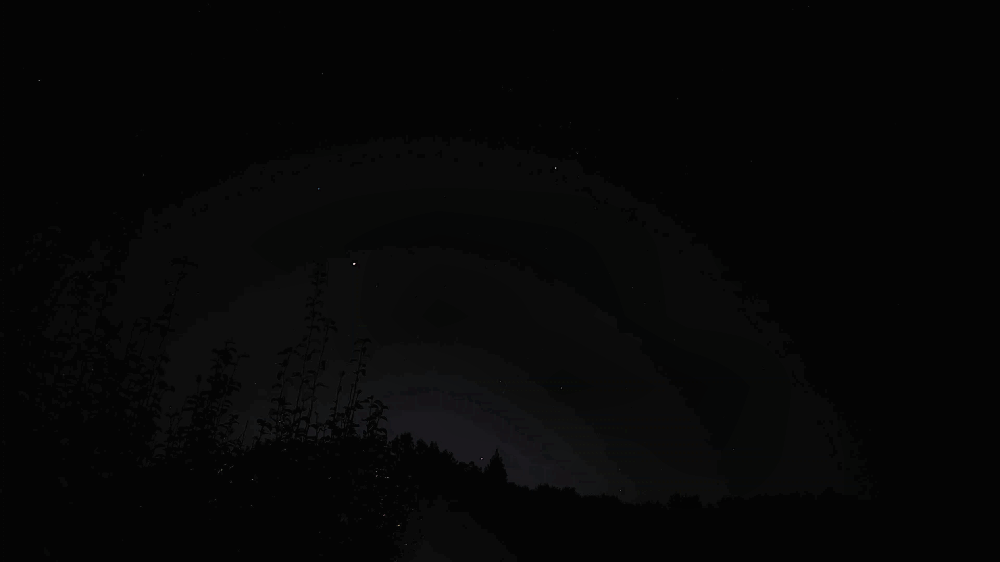

Clip Limit: 2.5, Tile Grid Size: (256, 256)


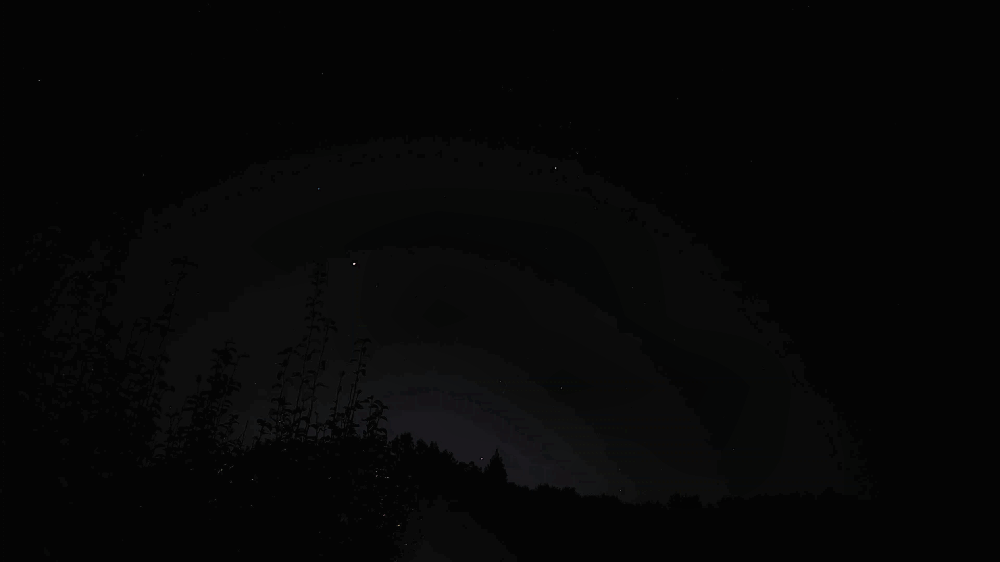

Clip Limit: 2.5, Tile Grid Size: (512, 512)


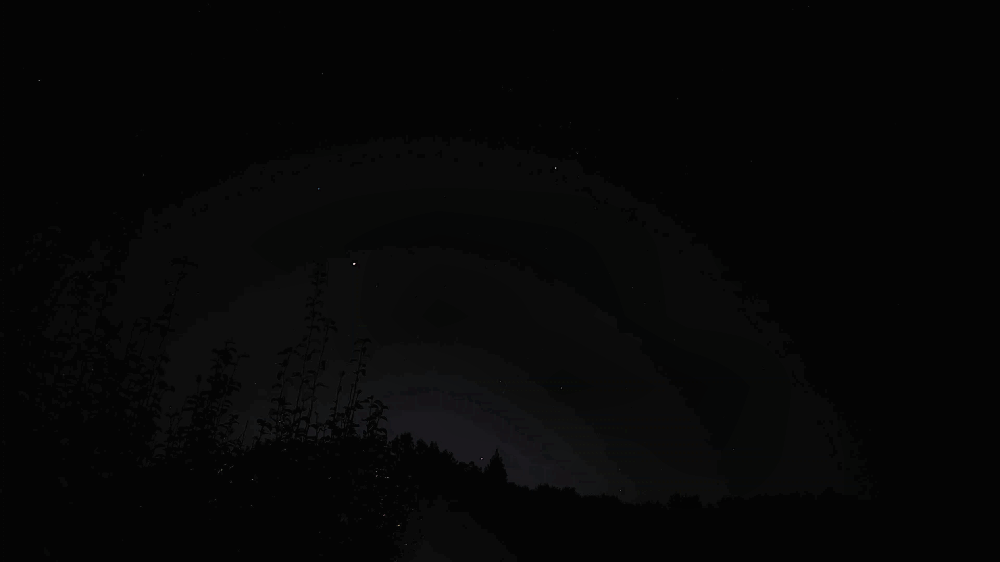

Clip Limit: 3.0, Tile Grid Size: (8, 8)


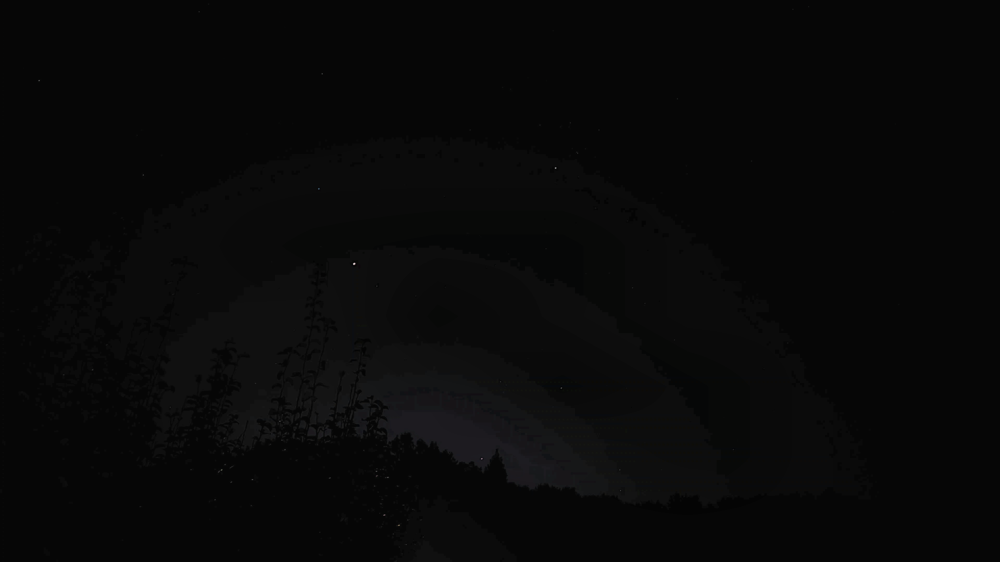

Clip Limit: 3.0, Tile Grid Size: (16, 16)


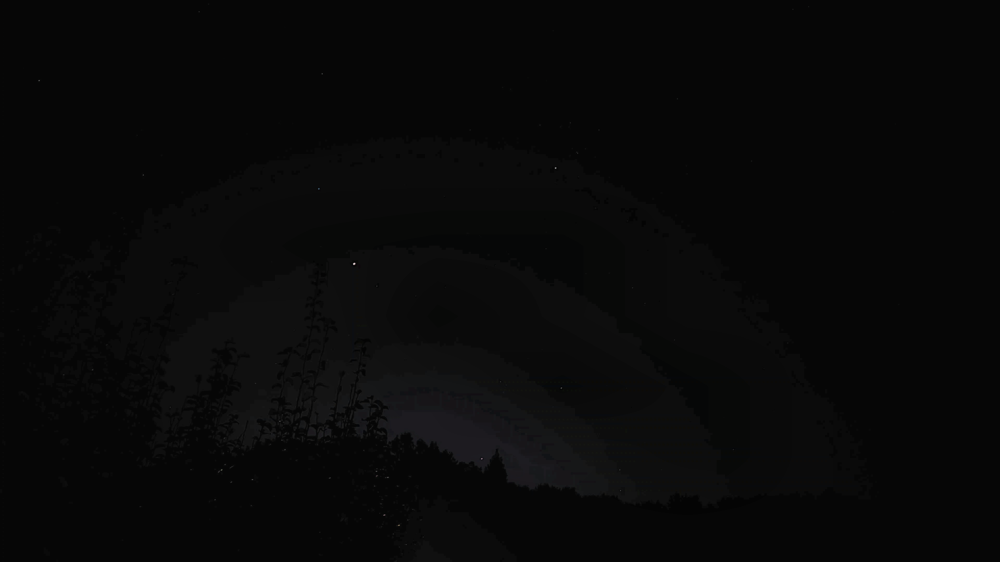

Clip Limit: 3.0, Tile Grid Size: (32, 32)


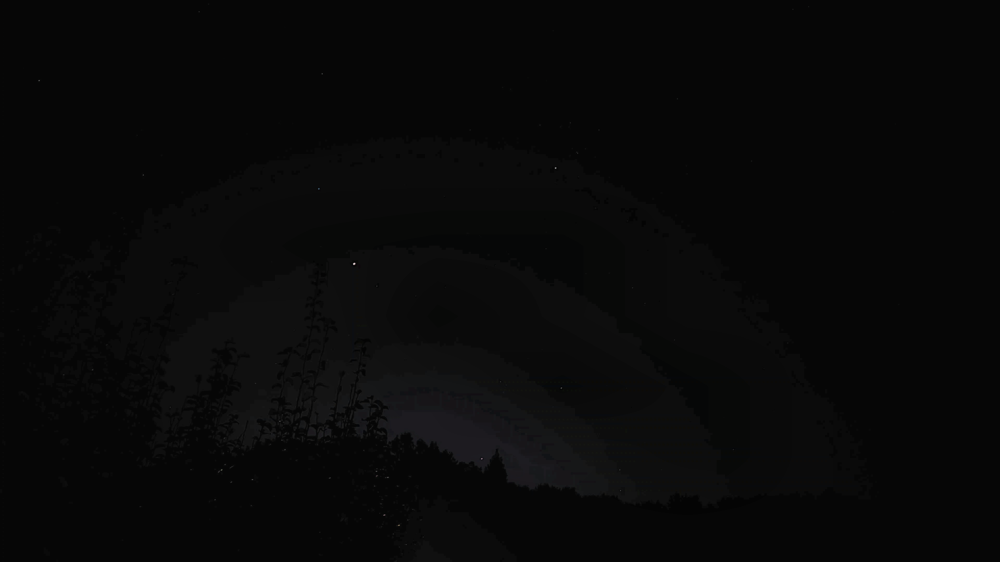

Clip Limit: 3.0, Tile Grid Size: (64, 64)


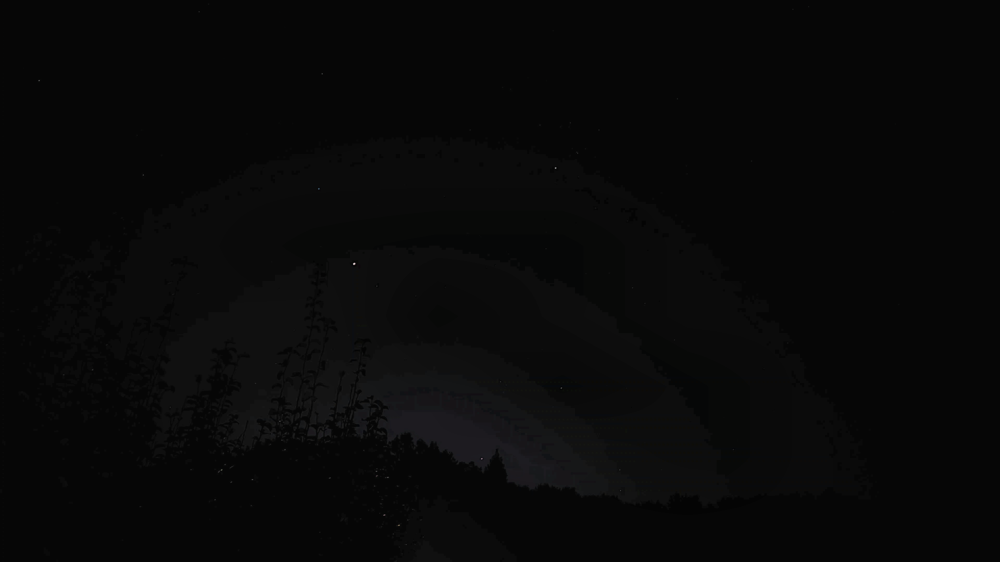

Clip Limit: 3.0, Tile Grid Size: (128, 128)


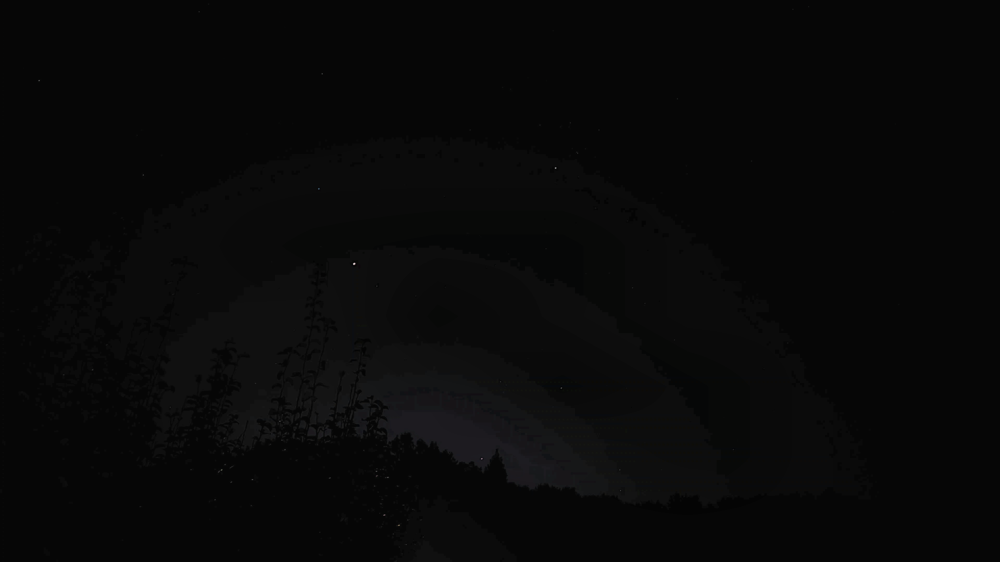

Clip Limit: 3.0, Tile Grid Size: (256, 256)


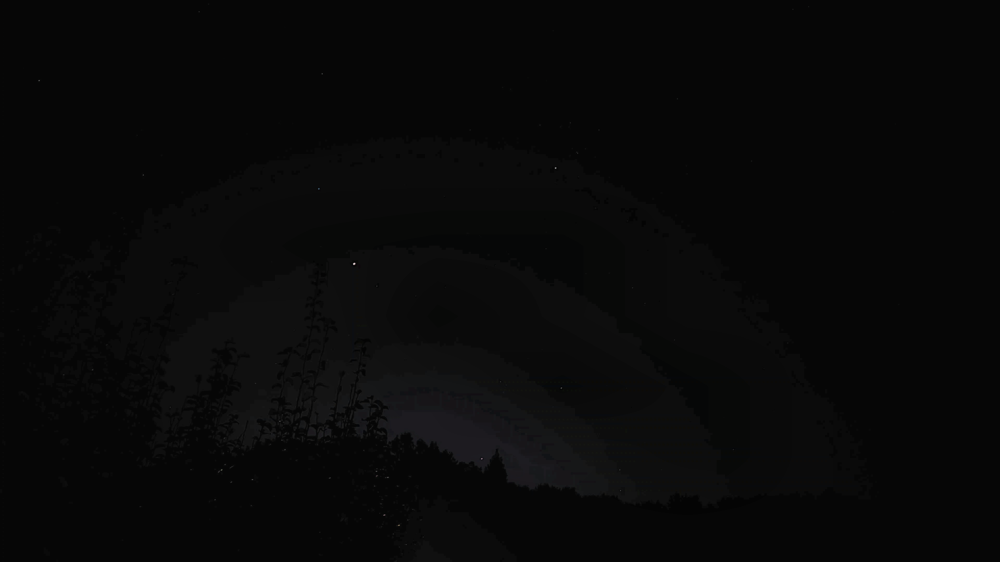

Clip Limit: 3.0, Tile Grid Size: (512, 512)


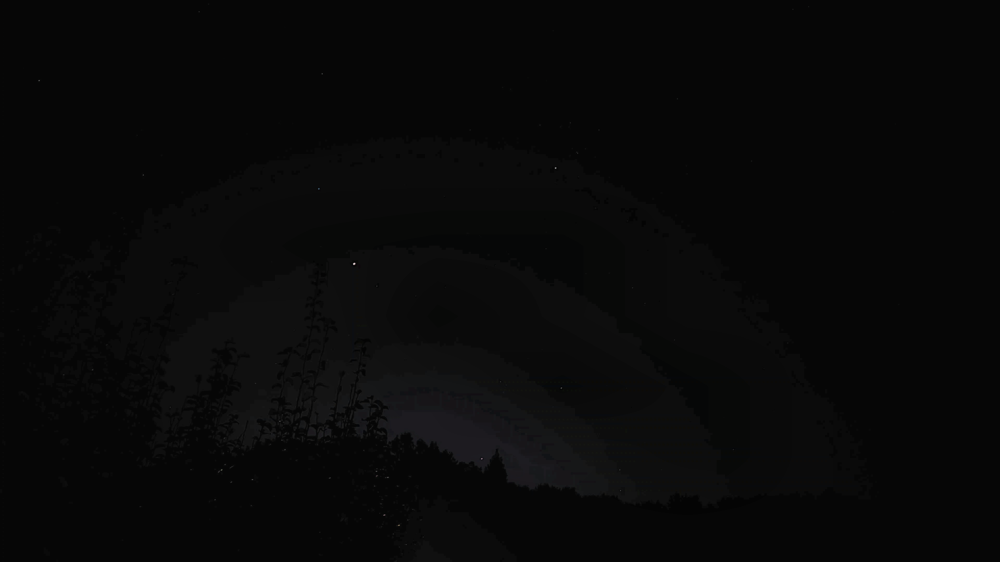

Maximum PSNR: 40.50337727981404 dB (from image frame_0001.jpg) with Clip Limit: 0.5, Tile Grid Size: (8, 8)


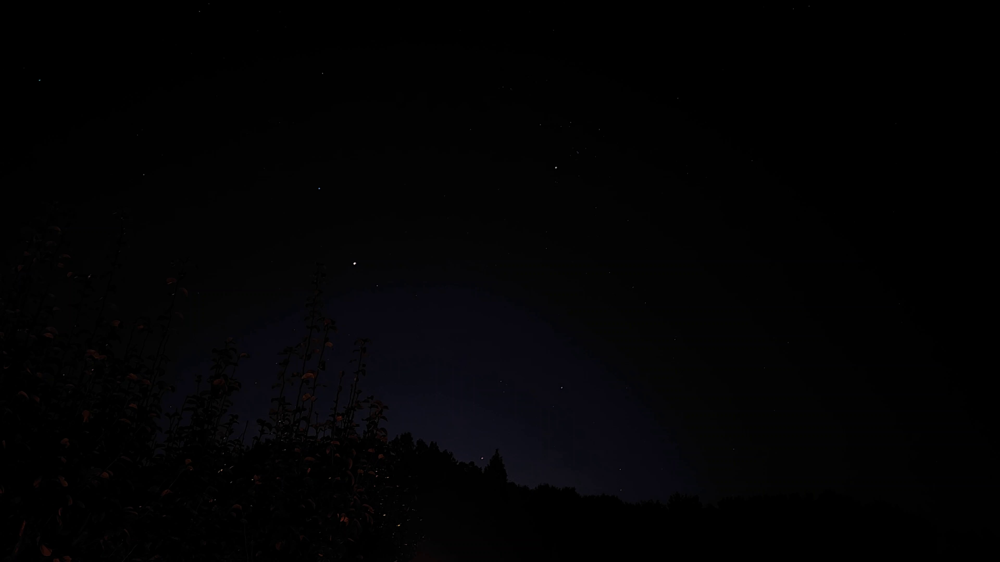

Clip Limit: 0.5, Tile Grid Size: (8, 8)


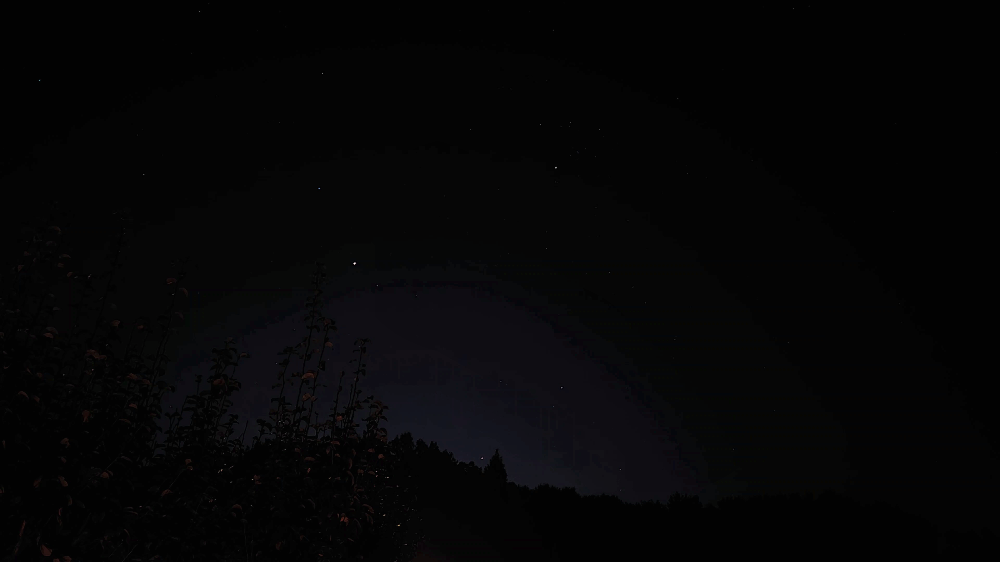

Clip Limit: 0.5, Tile Grid Size: (16, 16)


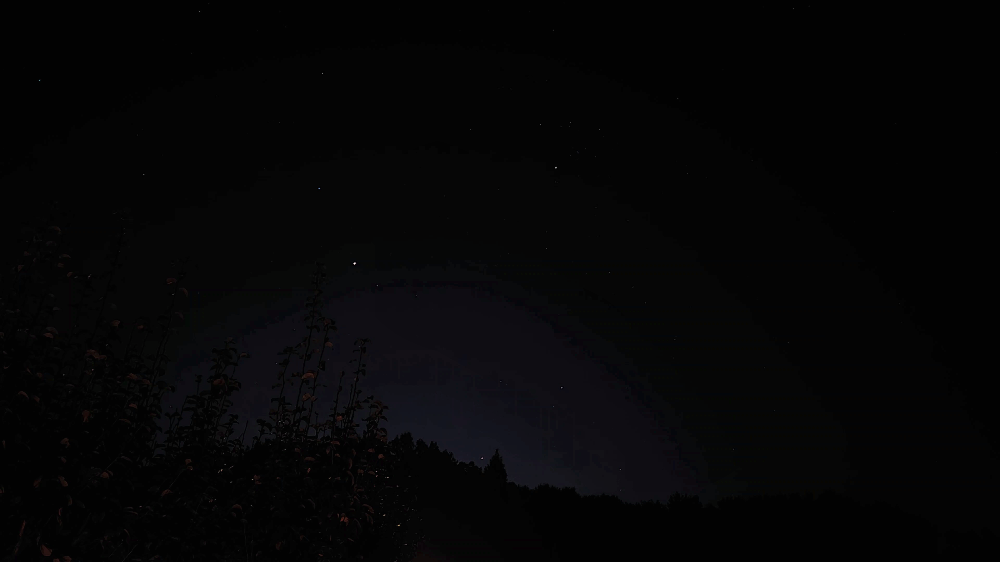

Clip Limit: 0.5, Tile Grid Size: (32, 32)


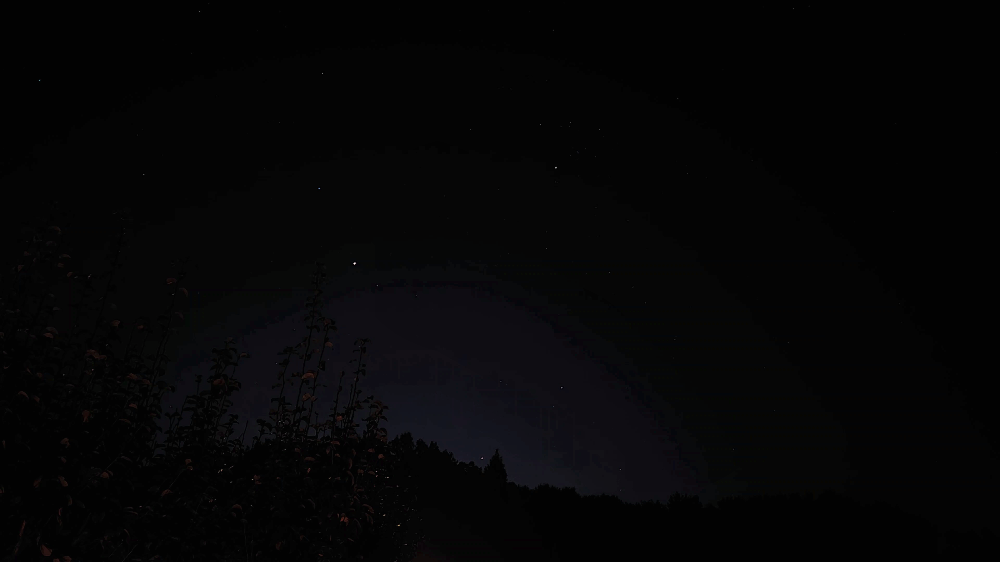

Clip Limit: 0.5, Tile Grid Size: (64, 64)


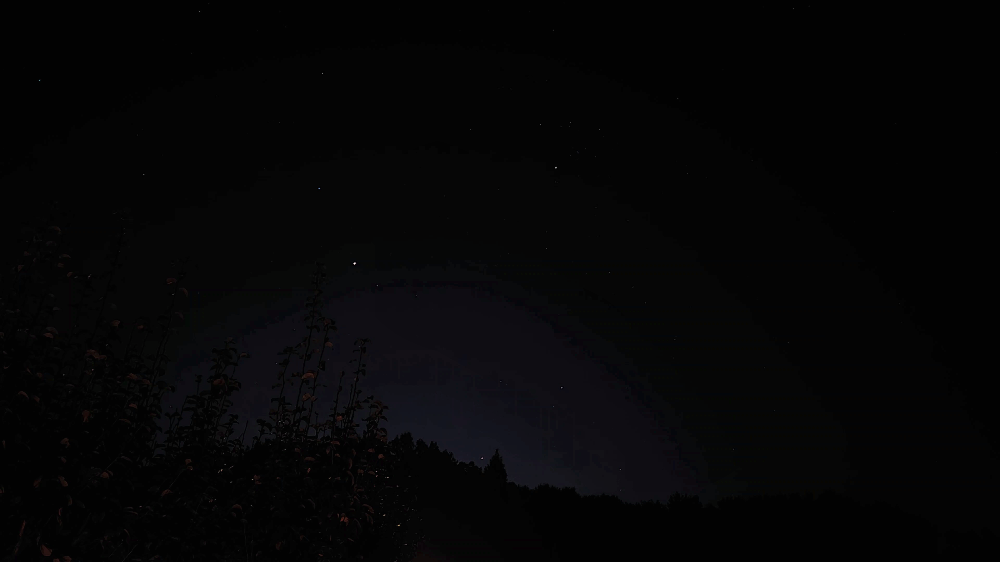

Clip Limit: 0.5, Tile Grid Size: (128, 128)


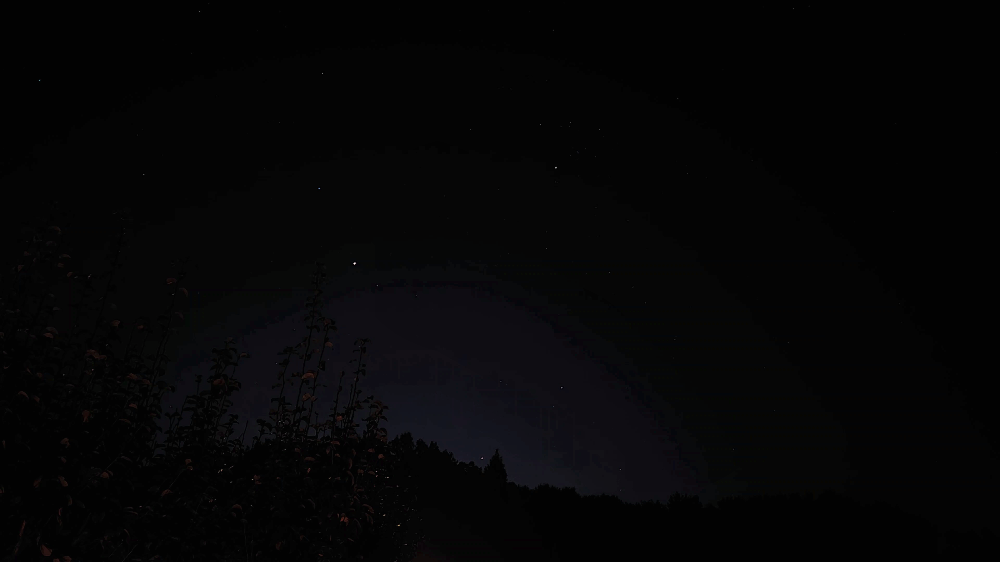

Clip Limit: 0.5, Tile Grid Size: (256, 256)


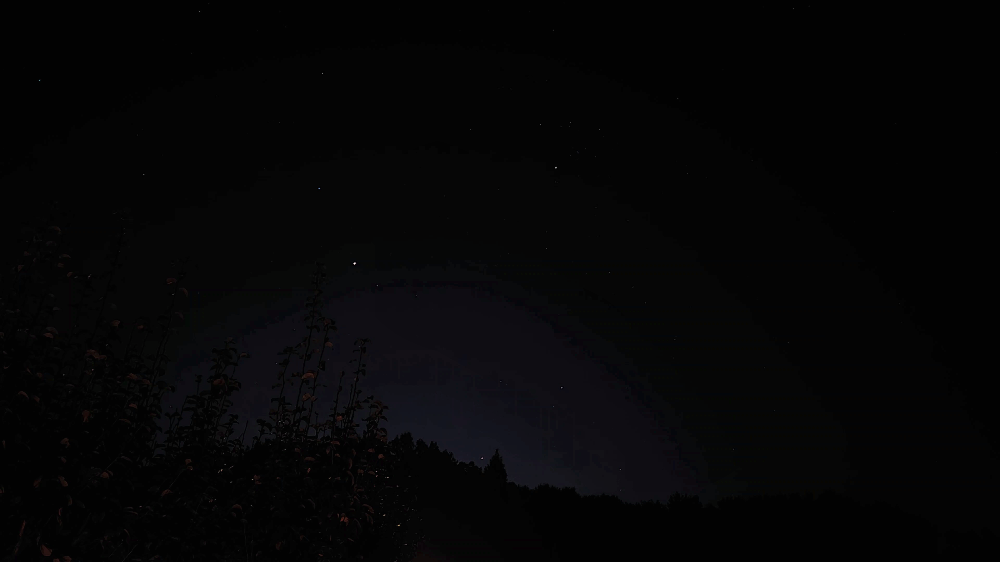

Clip Limit: 0.5, Tile Grid Size: (512, 512)


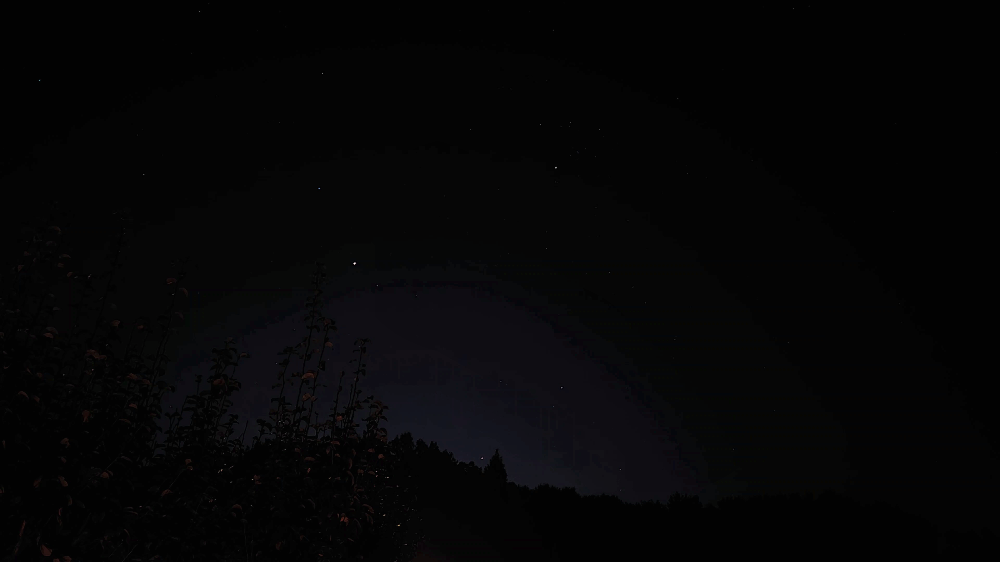

Clip Limit: 1.0, Tile Grid Size: (8, 8)


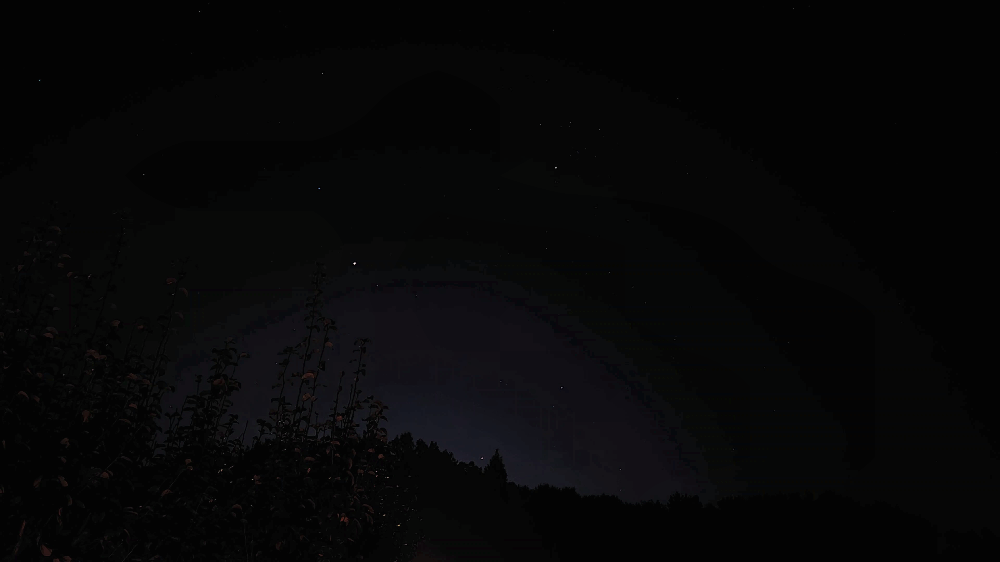

Clip Limit: 1.0, Tile Grid Size: (16, 16)


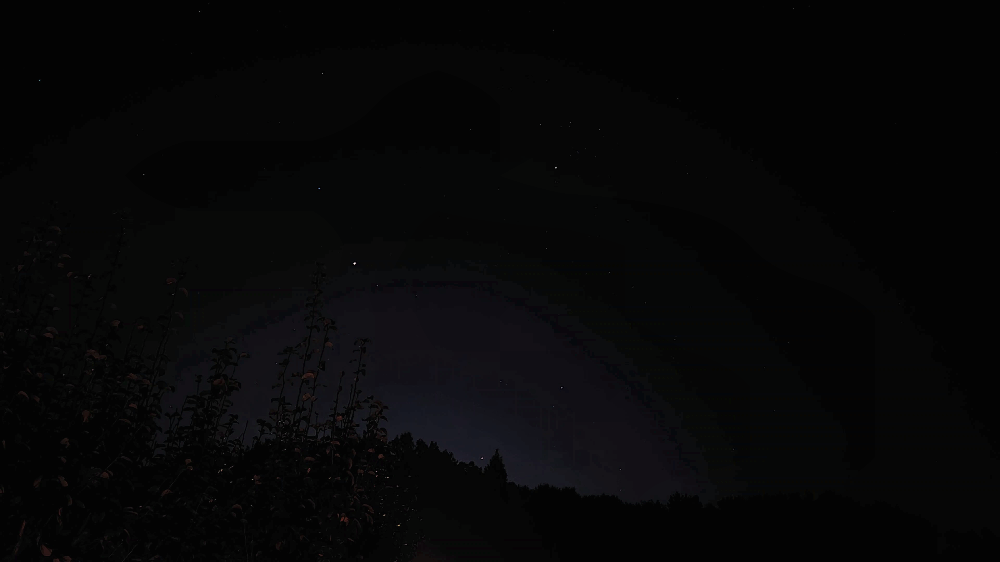

Clip Limit: 1.0, Tile Grid Size: (32, 32)


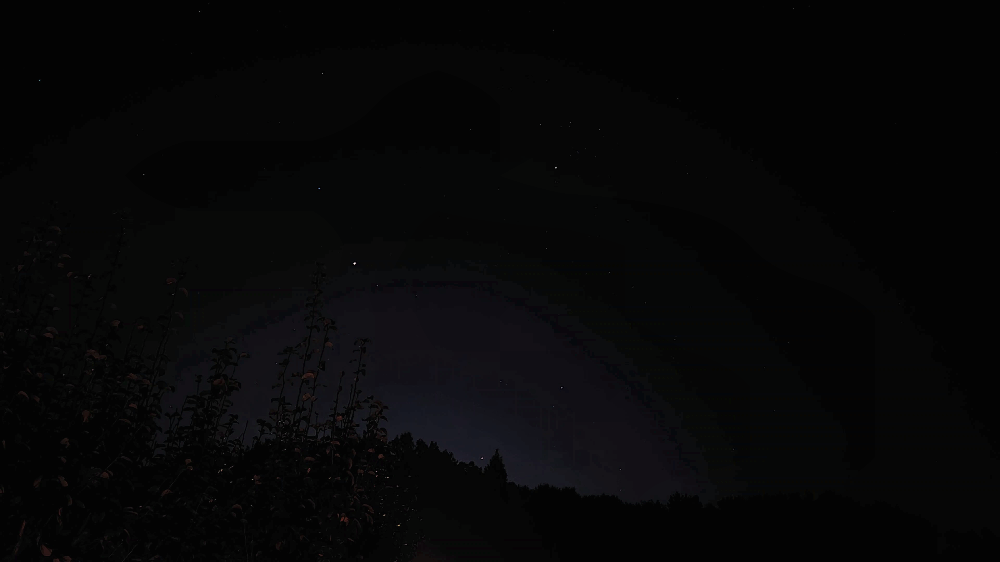

Clip Limit: 1.0, Tile Grid Size: (64, 64)


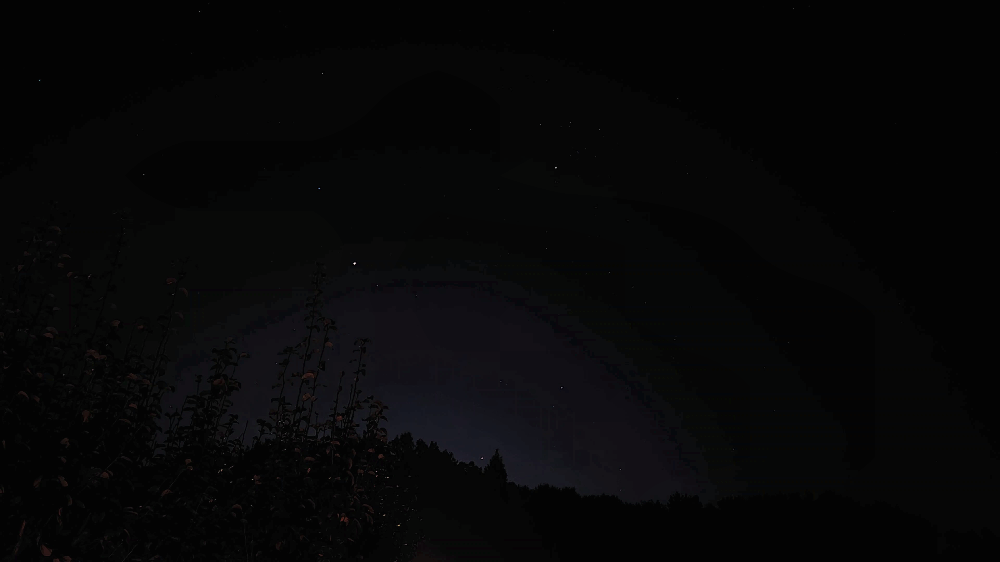

Clip Limit: 1.0, Tile Grid Size: (128, 128)


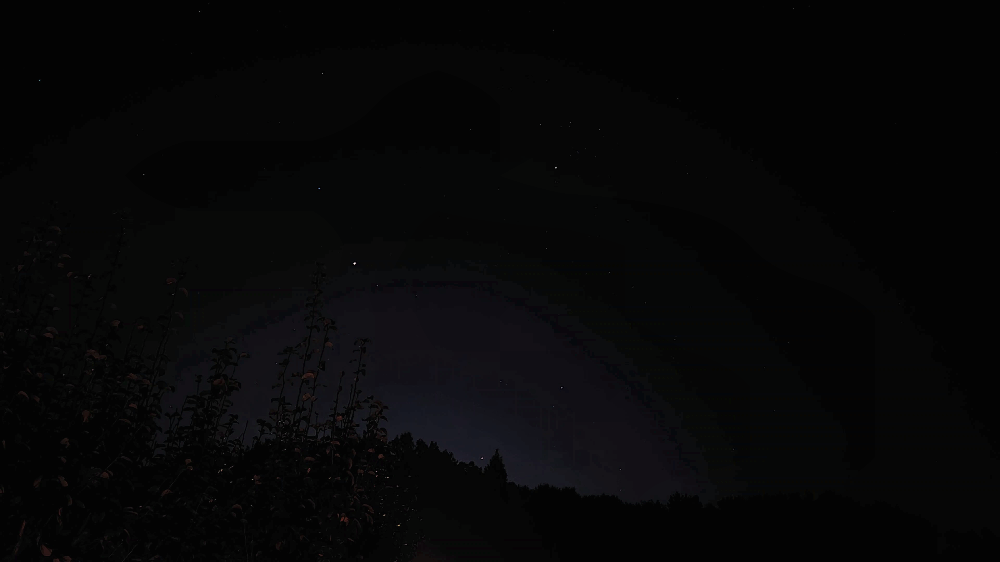

Clip Limit: 1.0, Tile Grid Size: (256, 256)


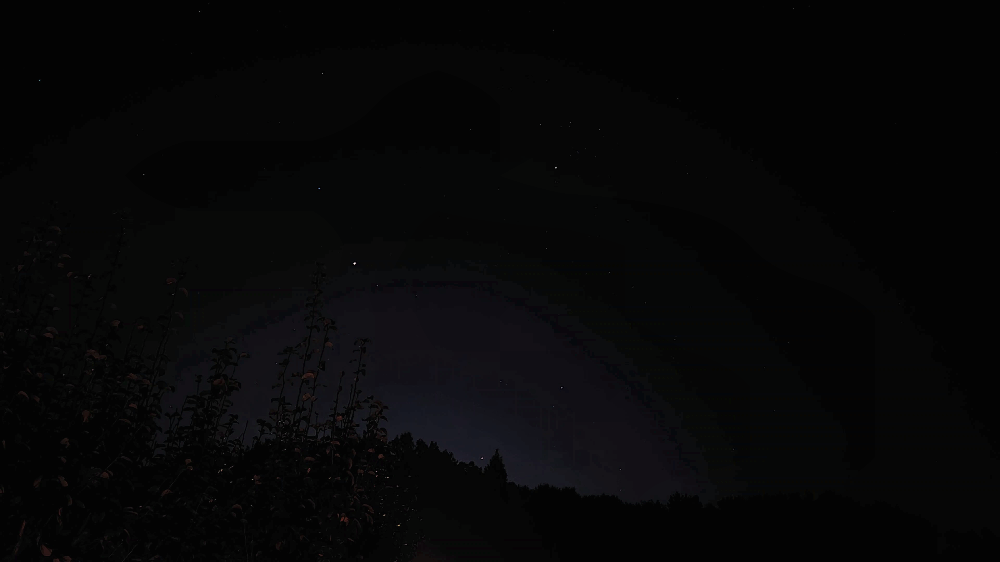

Clip Limit: 1.0, Tile Grid Size: (512, 512)


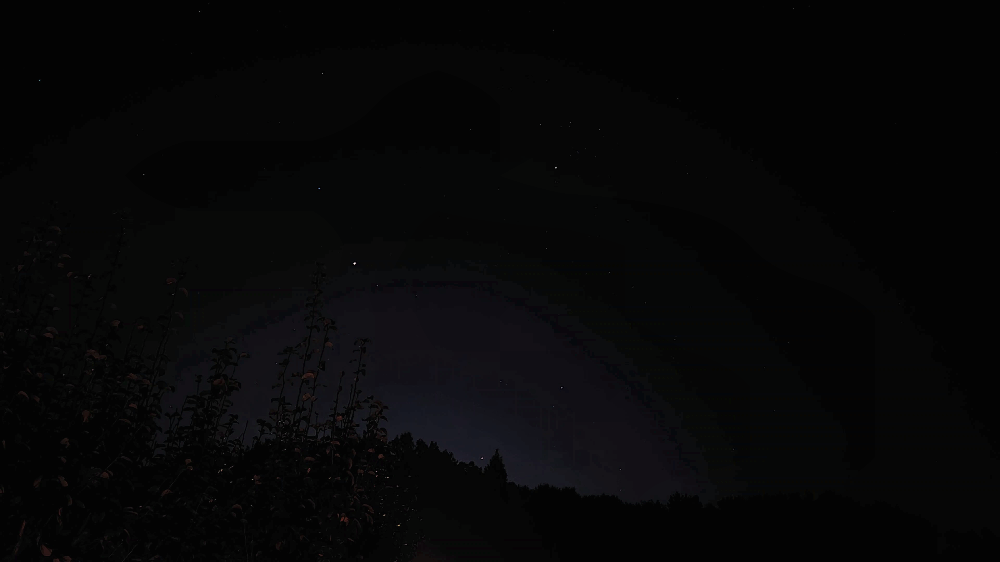

Clip Limit: 1.5, Tile Grid Size: (8, 8)


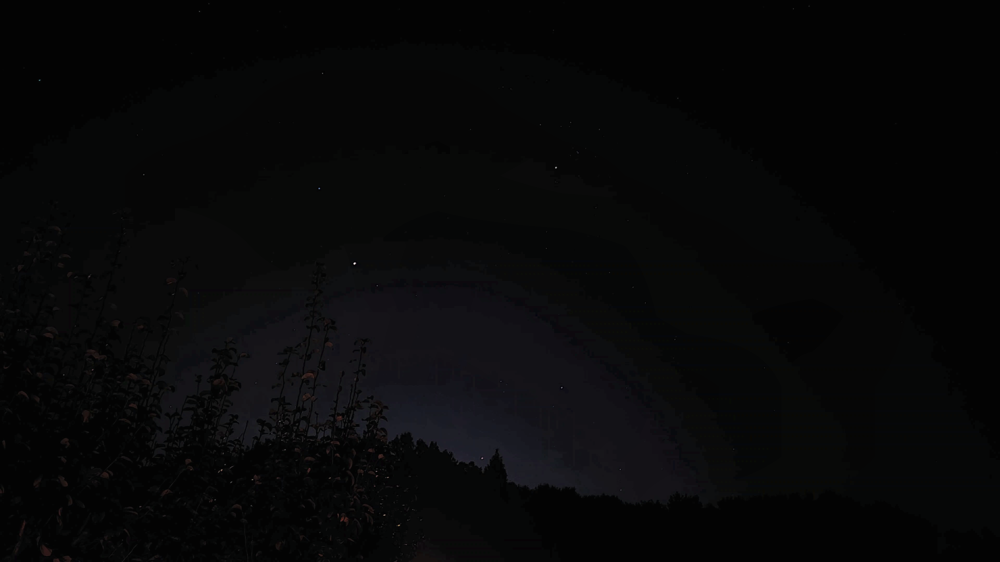

Clip Limit: 1.5, Tile Grid Size: (16, 16)


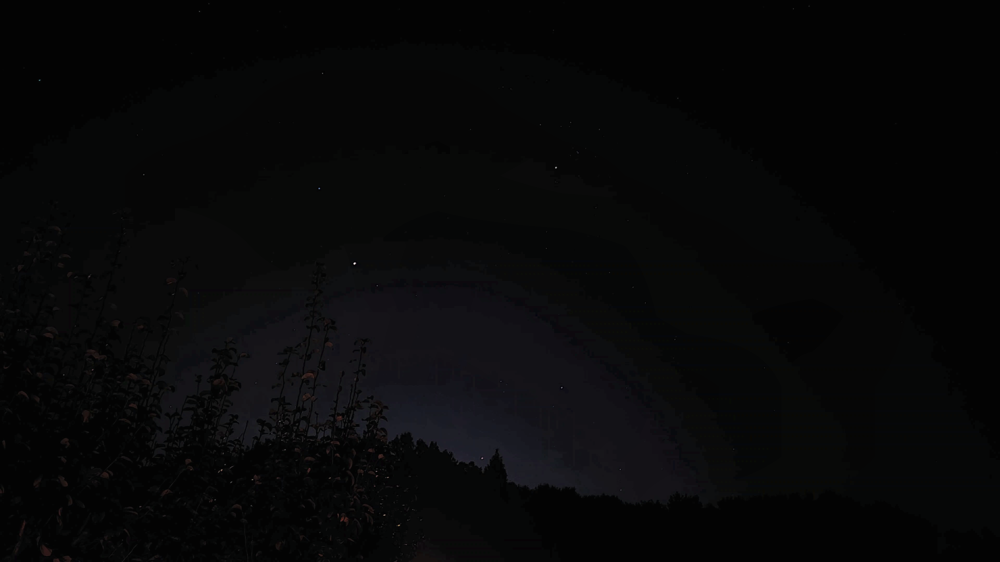

Clip Limit: 1.5, Tile Grid Size: (32, 32)


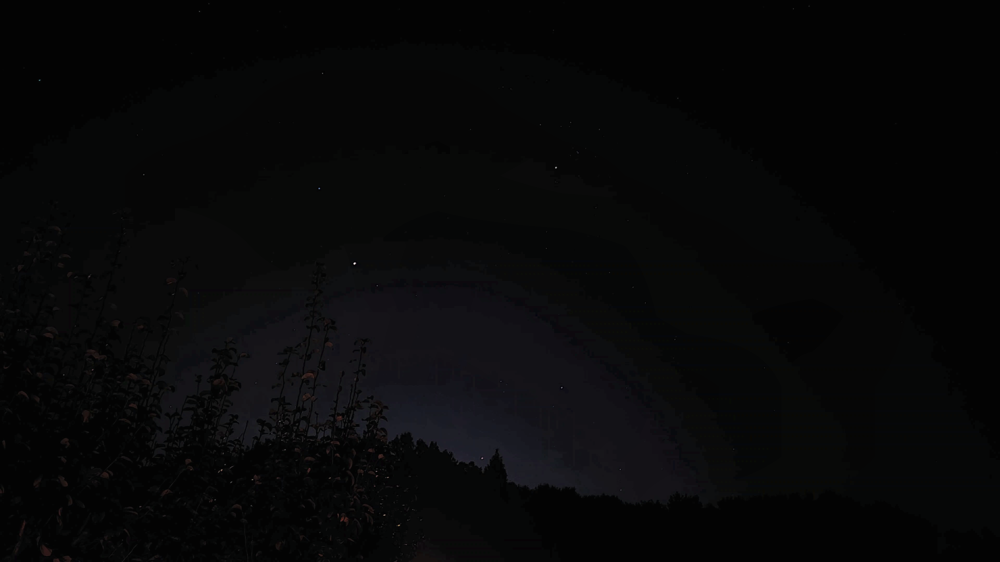

Clip Limit: 1.5, Tile Grid Size: (64, 64)


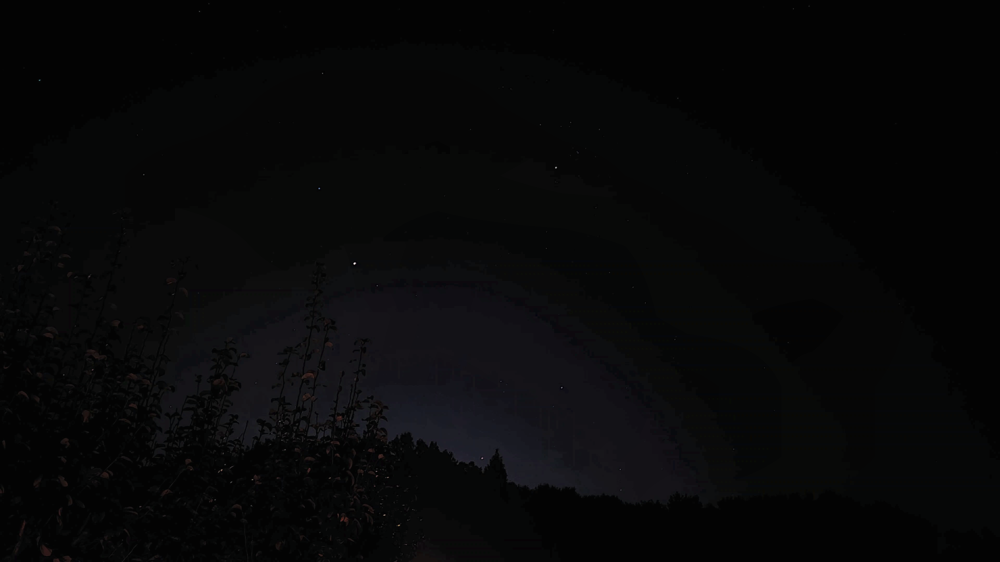

Clip Limit: 1.5, Tile Grid Size: (128, 128)


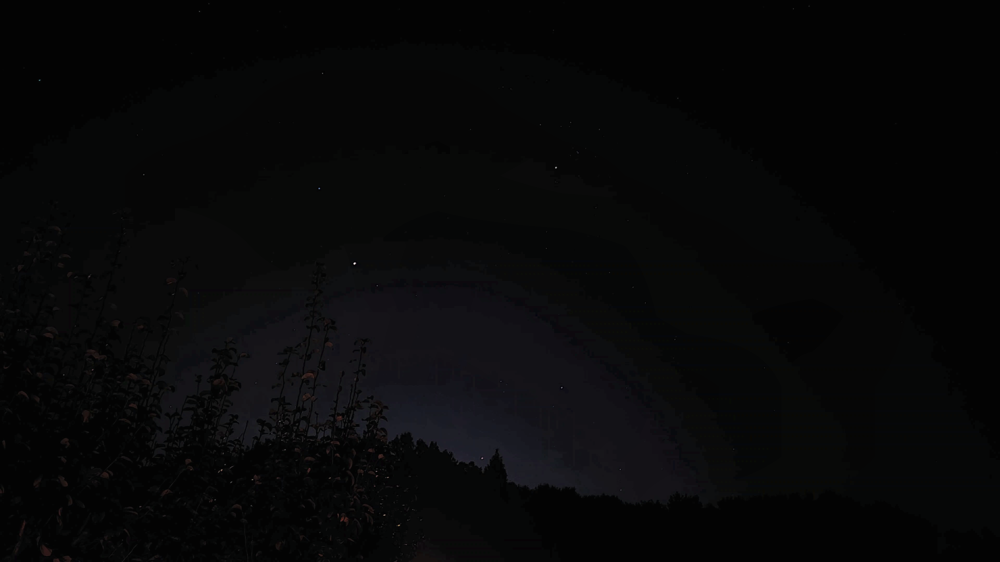

Clip Limit: 1.5, Tile Grid Size: (256, 256)


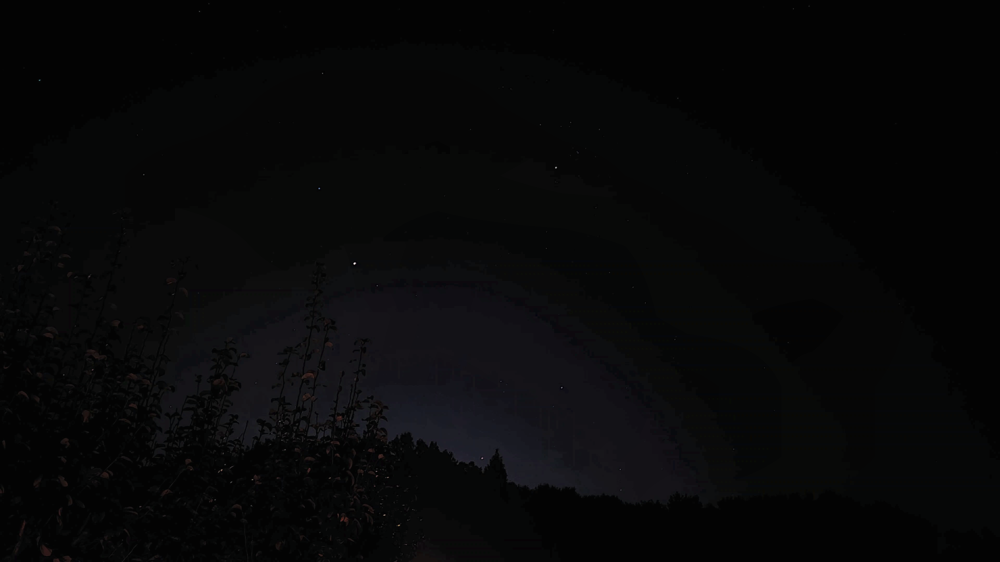

Clip Limit: 1.5, Tile Grid Size: (512, 512)


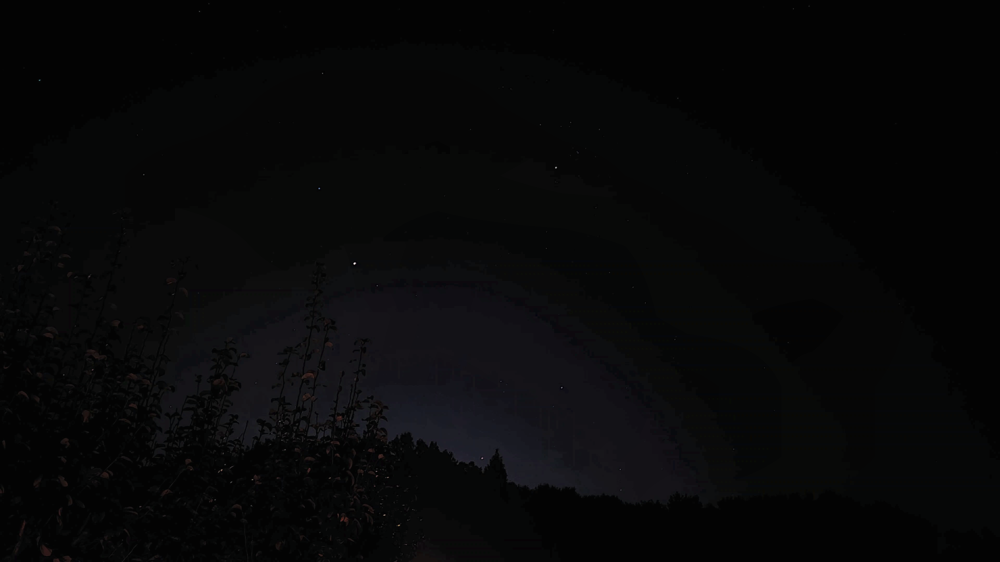

Clip Limit: 2.0, Tile Grid Size: (8, 8)


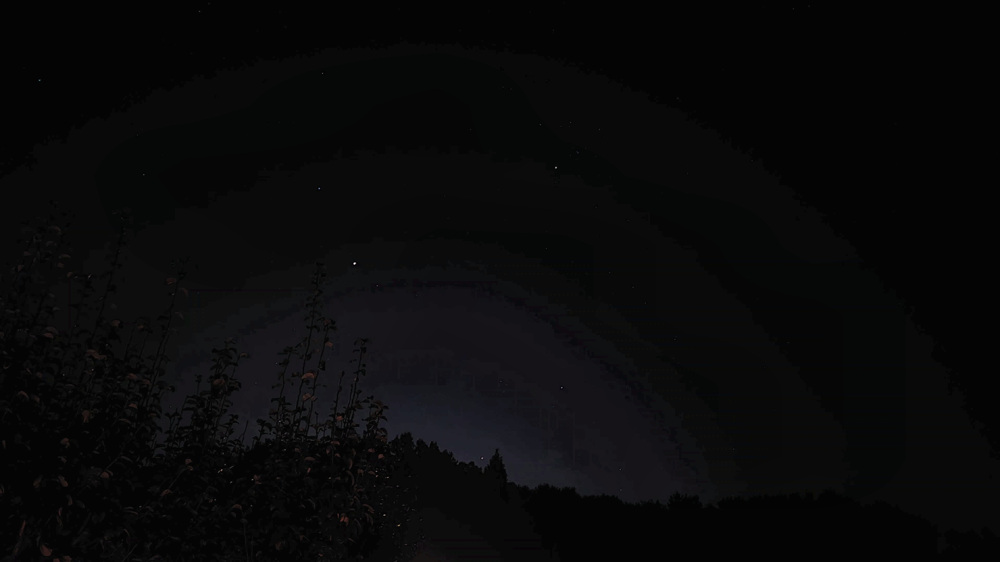

Clip Limit: 2.0, Tile Grid Size: (16, 16)


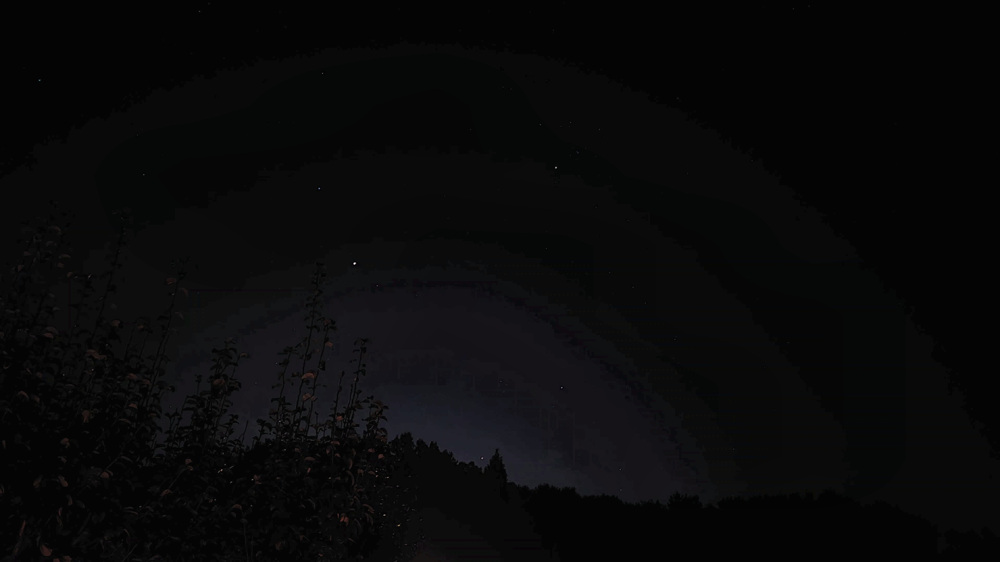

In [ ]:
for index, row in df.iterrows():
    max_psnr = -float('inf')
    max_psnr_clip_limit = None
    max_psnr_grid_size = None
    image_path = row['path_to_image']
    image_name=os.path.basename(image_path)
    # Process the image using its path
    image = cv2.imread(image_path)
    cv2_imshow(image)
    for clip_limit in clip_limits:
      for tile_grid_size in tile_grid_sizes:
        print(f"Clip Limit: {clip_limit}, Tile Grid Size: {tile_grid_size}")
        enhanced_image_resized, original_image = enhance_and_display(image_path, clip_limit=clip_limit, target_size=(3840, 2160))
        psnr_value = peak_signal_noise_ratio(original_image, enhanced_image_resized, data_range=enhanced_image_resized.max())
        if psnr_value>max_psnr:
          max_psnr=psnr_value
          max_psnr_clip_limit = clip_limit
          max_psnr_grid_size = tile_grid_size
    df.loc[index, 'clip_limit'] = max_psnr_clip_limit
    df.loc[index, 'grid_size'] = max_psnr_grid_size[0]
    print(f"Maximum PSNR: {max_psnr} dB (from image {image_name}) with Clip Limit: {max_psnr_clip_limit}, Tile Grid Size: {max_psnr_grid_size}")




In [ ]:
df

,path_to_image,mean_intensity,std_intensity,skewness,kurt,entropy,clip_limit,grid_size
0,/content/drive/My Drive/frames/20221021_00/fra...,0.931688,1.885240,14.749312,1152.671041,1.804917,0.5,8
1,/content/drive/My Drive/frames/20221021_00/fra...,2.558106,3.699154,4.583497,120.578554,2.957426,0.5,8
2,/content/drive/My Drive/frames/20221021_00/fra...,0.303704,1.001360,58.530286,9828.893632,0.937212,0.5,8
3,/content/drive/My Drive/frames/20221021_00/fra...,19.095710,16.263418,1.185256,1.401435,5.583037,0.5,8
4,/content/drive/My Drive/frames/20221021_00/fra...,5.941902,6.183962,2.385815,21.749580,3.982599,0.5,8
5,/content/drive/My Drive/frames/20221021_00/fra...,7.646898,7.840133,2.014865,10.903923,4.343448,0.5,8
6,/content/drive/My Drive/frames/20221021_00/fra...,18.788064,16.265447,1.194319,1.415220,5.553953,0.5,8
7,/content/drive/My Drive/frames/20221021_00/fra...,9.987987,9.562686,1.766447,6.607256,4.696634,0.5,8
8,/content/drive/My Drive/frames/20221021_00/fra...,14.975500,13.513248,1.393262,2.648866,5.235305,0.5,8
